# Single Cell Sequencing: pipeline for analysis USING UMIs

We use Scanpy for quality control filtering of data and for basic analysis (such as dimensionality reduction and plotting).

Adata file format is used as a variable for all the notebook.

We add information from other .txt files that were provided by SciLife lab regarding the real or kept cell barcodes and the mapping from the barcodes to the position in the well.

We use the information of the position in the plate to define which cells were correponding to mock or different stimuli experiments, as well as to include the level of red and green fluorecence of those cells (from CAMPARI).

In [22]:
!pip install --quiet anndata
import numpy as np
import pandas as pd
import scanpy as sc
import scipy
import anndata as ad
from sklearn.decomposition import TruncatedSVD
import matplotlib
import matplotlib.pyplot as plt
import os 
#doublet detection
import scrublet as scr
#batch correction (not installed by default in the docker container, install via command line: pip install scanorama bbknn)
import scanorama as scan
#external modules
import scanpy.external as sce
#pretty plotting
import seaborn as sb
import sys 
sb.set_context(context='poster')

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80)

scanpy==1.9.2 anndata==0.8.0 umap==0.5.3 numpy==1.23.5 scipy==1.9.2 pandas==1.3.5 scikit-learn==1.2.1 statsmodels==0.13.5 python-igraph==0.10.3 louvain==0.8.0 pynndescent==0.5.8


## SECTION I: Data loading, cell selection and data agregation

Here we declare file paths assuming fastq files had been already decompressed. 

We need adata file path (kallisto output), kept cell barcodes file (provided by scilife lab), 
all cell barcodes file (kallisto output), plate-cell barcode ID file (provided by scilife lab),
and flourecence information (file manually created with plate position info, flourence level, and our cell number).

This section loads all these files, and the final output is an anndata format count matrix with data agregation from all plates.

In [23]:
# load the unfiltered matrix and define all paths for storing data
figure_path = '/home/melma31/Documents/single_cell_sequencing/figures/'
results_file_sample1 = '/home/melma31/Documents/single_cell_sequencing/src/sample1/counts_unfiltered_umi/adata.h5ad'  # the file that will store the analysis results
results_file_sample2 = '/home/melma31/Documents/single_cell_sequencing/src/sample2/counts_unfiltered_umi/adata.h5ad'  # the file that will store the analysis results
results_file_sample3 = '/home/melma31/Documents/single_cell_sequencing/src/sample3/counts_unfiltered_umi/adata.h5ad'  # the file that will store the analysis results

#txt file with kept cells
cell_barcode_file_sample1 = '/home/melma31/Documents/single_cell_sequencing/SS3_22_291/zUMIs_output/SS3_22_291kept_barcodes.txt'
cell_barcode_file_sample2 = '/home/melma31/Documents/single_cell_sequencing/SS3_23_049/zUMIs_output/SS3_23_049kept_barcodes.txt'
cell_barcode_file_sample3 = '/home/melma31/Documents/single_cell_sequencing/SS3_23_127/zUMIs_output/SS3_23_127kept_barcodes.txt'

#read barcodes with kalisto
cell_barcode_file_new_sample1 = '/home/melma31/Documents/single_cell_sequencing/src/sample1/counts_unfiltered_umi/cells_x_genes.barcodes.txt'
cell_barcode_file_new_sample2 = '/home/melma31/Documents/single_cell_sequencing/src/sample2/counts_unfiltered_umi/cells_x_genes.barcodes.txt'
cell_barcode_file_new_sample3 = '/home/melma31/Documents/single_cell_sequencing/src/sample3/counts_unfiltered_umi/cells_x_genes.barcodes.txt'

#txt file with well barcodes. the text contains the cell barcode corresponding to each position in the plate
well_barcode_sample1 = '/home/melma31/Documents/single_cell_sequencing/SS3_22_291/zUMIs_output/stats/SS3_22_291.well_barcodes.txt'
well_barcode_sample2 = '/home/melma31/Documents/single_cell_sequencing/SS3_23_049/zUMIs_output/stats/SS3_23_049.well_barcodes.txt'
well_barcode_sample3 = '/home/melma31/Documents/single_cell_sequencing/SS3_23_127/zUMIs_output/stats/SS3_23_127.well_barcodes.txt'

###upload excel with red and green flourecence from campari (has information about position in plate and fluorecence level)
florecence_1_file_path = '/home/melma31/Documents/single_cell_sequencing/data/well_1_data_base.csv'
florecence_2_file_path = '/home/melma31/Documents/single_cell_sequencing/data/well_2_data_base.csv'
florecence_3_file_path = '/home/melma31/Documents/single_cell_sequencing/data/well_3_data_base.csv'

In [24]:
### load raw adata file using adata libraty
sample1 = ad.read_h5ad(results_file_sample1)
sample2 = ad.read_h5ad(results_file_sample2)
sample3 = ad.read_h5ad(results_file_sample3)

### read fluorecence levels
flourecence1 = pd.read_csv(florecence_1_file_path)
flourecence2 = pd.read_csv(florecence_2_file_path)
flourecence3 = pd.read_csv(florecence_3_file_path)

### read kept barcodes and barcodes provided by kalisto
df_1_sample1 = pd.read_csv(cell_barcode_file_sample1, delimiter = "\,")
df_2_sample1 = pd.read_csv(cell_barcode_file_new_sample1)

df_1_sample2 = pd.read_csv(cell_barcode_file_sample2, delimiter = "\,")
df_2_sample2 = pd.read_csv(cell_barcode_file_new_sample2)

df_1_sample3 = pd.read_csv(cell_barcode_file_sample3, delimiter = "\,")
df_2_sample3 = pd.read_csv(cell_barcode_file_new_sample3)

### merge data base. Merge information about cell barcode and fluorecence 
### (using as common demonimator the position in the plate)
barcode_list_sample1 = list(df_1_sample1['XC'])
well_df_sample1 = pd.read_csv(well_barcode_sample1, delimiter = "\t")
mergedRes1 = pd.merge(well_df_sample1 , flourecence1, on ='well_id')

barcode_list_sample2 = list(df_1_sample2['XC'])
well_df_sample2 = pd.read_csv(well_barcode_sample2, delimiter = "\t")
mergedRes2 = pd.merge(well_df_sample2 , flourecence2, on ='well_id')

barcode_list_sample3 = list(df_1_sample3['XC'])
well_df_sample3 = pd.read_csv(well_barcode_sample3, delimiter = "\t")
mergedRes3 = pd.merge(well_df_sample3 , flourecence3, on ='well_id')

/home/melma31/mambaforge/lib/python3.10/site-packages/pandas/util/_decorators.py:311: ParserWarning: Falling back to the 'python' engine because the 'c' engine does not support regex separators (separators > 1 char and different from '\s+' are interpreted as regex); you can avoid this warning by specifying engine='python'.
  return func(*args, **kwargs)


In [25]:
def barcode_check(df_1,df_2,barcode_list,mergedRes):

    #print(barcode_list)
    kept_cells = np.zeros((len(df_1),))
    well_id = np.zeros((len(df_1),))

    red_f = np.zeros((len(df_1),))
    green_f = np.zeros((len(df_1),))
    stimulus = np.zeros((len(df_1),))

    index_vector = np.zeros((len(df_1),))
    count = 0
    counter = 0
    for i in range(len(df_2)):
        x = df_2.iloc[i]['Barcodes']
        if x in barcode_list:
            index = barcode_list.index(x)
            index_vector[count] = index
            if len(np.where(np.isnan(mergedRes['stimulus'].where(mergedRes['bc_set'] == x))==False)):
                counter+=1
                position = np.where(np.isnan(mergedRes['stimulus'].where(mergedRes['bc_set'] == x))==False)[0][0]
                stimulus[index] = mergedRes['stimulus'].where(mergedRes['bc_set'] == x)[position]
                red_f[index] = mergedRes['red_f'].where(mergedRes['bc_set'] == x)[position]
                green_f[index] = mergedRes['green_f'].where(mergedRes['bc_set'] == x)[position]
                kept_cells[index] = int(i)
                well_id[index] = 1
                count +=1
    #kept_cells = np.unique(kept_cells)
    count = len(df_1)
    
    return kept_cells, well_id,stimulus,red_f,green_f


In [26]:
kept_cells1, well_id1,stimulus_1,red_f1,green_f1 = barcode_check(df_1_sample1,df_2_sample1,barcode_list_sample1,mergedRes1)
kept_cells2, well_id2,stimulus_2,red_f2,green_f2 = barcode_check(df_1_sample2,df_2_sample2,barcode_list_sample2,mergedRes2)
kept_cells3, well_id3,stimulus_3,red_f3,green_f3 = barcode_check(df_1_sample3,df_2_sample3,barcode_list_sample3,mergedRes3)


In [27]:
### select only kept cells
adata1 = sample1[kept_cells1.astype(int),:]
adata2 = sample2[kept_cells2.astype(int),:]
adata3 = sample3[kept_cells3.astype(int),:]


### add campari information to adata structure
adata1.obs['stimulus'] = stimulus_1 
adata1.obs['red'] = red_f1
adata1.obs['green'] = green_f1
adata1.obs['well_id'] = well_id1

adata2.obs['stimulus'] = stimulus_2
adata2.obs['red'] = red_f2
adata2.obs['green'] = green_f2
adata2.obs['well_id'] = well_id2


adata3.obs['stimulus'] = stimulus_3
adata3.obs['red'] = red_f3
adata3.obs['green'] = green_f3
adata3.obs['well_id'] = well_id3


### data integration

adata_1 = adata1.concatenate(adata2, join='outer', batch_categories=['sample1', 'sample2'], index_unique='-')
adata = adata_1.concatenate(adata3, join='outer', batch_categories=['sample12', 'sample3'], index_unique='-')

print('Number of cells:', adata.X.shape[0])
print('Number of genes:', adata.X.shape[1])

/tmp/ipykernel_13350/2144263004.py:8: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata1.obs['stimulus'] = stimulus_1
/home/melma31/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/tmp/ipykernel_13350/2144263004.py:13: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata2.obs['stimulus'] = stimulus_2
/tmp/ipykernel_13350/2144263004.py:19: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata3.obs['stimulus'] = stimulus_3
/home/melma31/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly t

Number of cells: 1152
Number of genes: 55421


## SECTION II: Quality control

In [28]:
# Quality control - calculate QC covariates
adata.obs['n_counts'] = adata.X.sum(axis = 1)
x =  adata.X.sum(axis = 1)
adata.obs['log_counts'] = np.log(x)
adata.obs['n_genes'] = (adata.X > 0).sum(axis = 1)

In [29]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`

In [30]:
mt_gene_mask = np.flatnonzero([gene.startswith('mt-') for gene in adata.var_names])
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
y = np.sum(adata[:, mt_gene_mask].X, axis=1).A1.reshape(-1,)
z = np.array(adata.obs['n_counts']).reshape(-1,)
adata.obs['mt_frac'] = y/z

normalizing counts per cell
    finished (0:00:00)


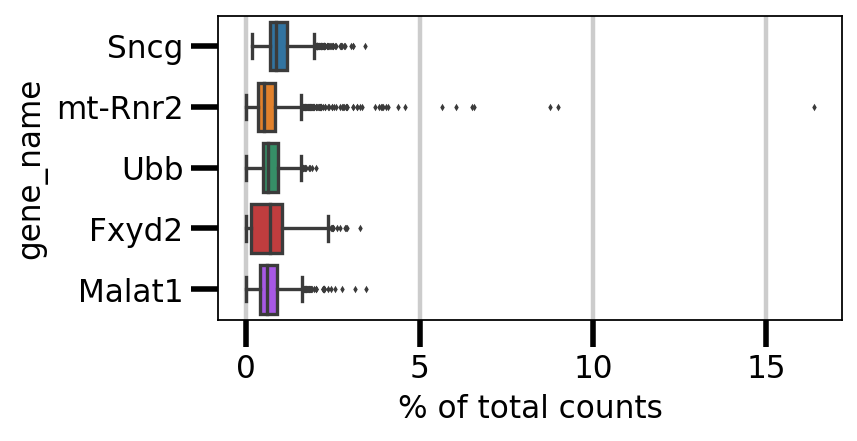

In [31]:
adata.var["gene_id"] = adata.var.index.values

t2g = pd.read_csv("t2g.txt", header=None, names=["tid", "gene_id", "gene_name"], sep="\t")
t2g.index = t2g.gene_id
t2g = t2g.loc[~t2g.index.duplicated(keep='first')]

adata.var["gene_name"] = adata.var.gene_id.map(t2g["gene_name"])
adata.var.index = adata.var["gene_name"]

sc.pl.highest_expr_genes(adata, n_top=5)

adata.var["mt"] = adata.var_names.str.startswith("MT-")
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)

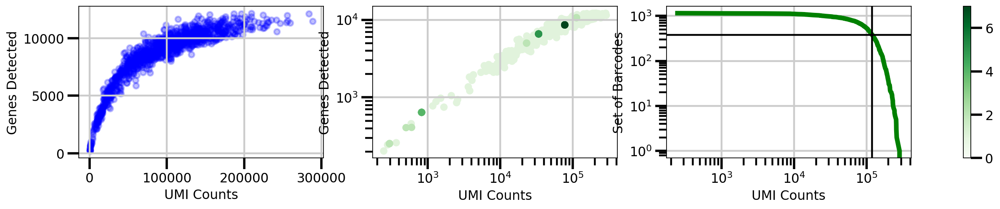

In [32]:
#Create a plot showing genes detected as a function of UMI counts.
fig, ax = plt.subplots(1,3)
x = np.asarray(adata.X.sum(axis=1))[:,0]
y = np.asarray(np.sum(adata.X>0, axis=1))[:,0]
ax[0].scatter(x, y, color="b", alpha=0.25)
ax[0].set_ylabel("Genes Detected")
ax[0].set_xlabel("UMI Counts")
#ax.set_xscale('log')
#ax.set_yscale('log')

#histogram definition
bins = [1500, 1500] # number of bins
# histogram the data
hh, locx, locy = np.histogram2d(x, y, bins=bins)
# Sort the points by density, so that the densest points are plotted last
z = np.array([hh[np.argmax(a<=locx[1:]),np.argmax(b<=locy[1:])] for a,b in zip(x,y)])
idx = z.argsort()
x2, y2, z2 = x[idx], y[idx], z[idx]

s = ax[1].scatter(x2, y2, c=z2, cmap='Greens')  
fig.colorbar(s, ax=ax)

ax[1].set_xscale('log')
ax[1].set_yscale('log')
ax[1].set_xlabel("UMI Counts")
ax[1].set_ylabel("Genes Detected")


expected_num_cells =  380#@param {type:"integer"}
knee = np.sort((np.array(adata.X.sum(axis=1))).flatten())[::-1]

ax[2].loglog(knee, range(len(knee)), linewidth=5, color="g")
ax[2].axvline(x=knee[expected_num_cells], linewidth=2, color="k")
ax[2].axhline(y=expected_num_cells, linewidth=2, color="k")

ax[2].set_xlabel("UMI Counts")
ax[2].set_ylabel("Set of Barcodes")

#plt.grid(True, which="both")

fig.set_size_inches([20,3])
plt.show()
fig.savefig(figure_path + 'QC_UMI_genes_counts.png')

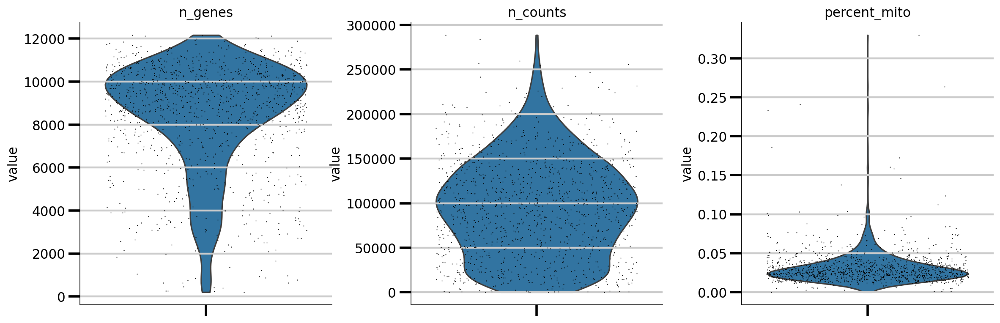

In [33]:
adata.var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`
### check for mitochandrial mRNA
mito_genes = adata.var_names.str.startswith('mt-')
# for each cell compute fraction of counts in mito genes vs. all genes
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
adata.obs['percent_mito'] = np.sum(
    adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1
# add the total counts per cell as observations-annotation to adata
adata.obs['n_counts'] = adata.X.sum(axis=1).A1
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'],
             jitter=0.4, multi_panel=True)

In [34]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata.n_obs))
#cell_subset = sc.pp.filter_cells(adata, min_counts = 1000)
#filter1 = kept_cells_stimuli[cell_subset[0]]
#red_filter1 = red_intensity[cell_subset[0]]
#green_filter1 = green_intensity[cell_subset[0]]
#well_id_filter1 = well_id[cell_subset[0]]
sc.pp.filter_cells(adata, min_counts = 1000)

Total number of cells: 1152
filtered out 12 cells that have less than 1000 counts


/home/melma31/mambaforge/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [35]:
print('Number of cells after min count filter: {:d}'.format(adata.n_obs))
#cell_subset = sc.pp.filter_cells(adata, min_genes = 1000,inplace=False)
#filter2 = filter1[cell_subset[0]]
#red_filter2 = red_filter1[cell_subset[0]]
#green_filter2 = green_filter1[cell_subset[0]]
#well_id_filter2 = well_id_filter1[cell_subset[0]]
sc.pp.filter_cells(adata, min_genes = 1000)

Number of cells after min count filter: 1140
filtered out 6 cells that have less than 1000 genes expressed


In [36]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))
# Min 20 cells - filters out 0 count genes
sc.pp.filter_genes(adata, min_cells=5)
#sc.pp.filter_genes(adata, min_counts=10)


Total number of genes: 55421
filtered out 29491 genes that are detected in less than 5 cells


In [37]:
adata.var['mt'] = adata.var_names.str.startswith('mt-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
print(adata.shape)

(1134, 25930)


## SECTION III: Analysis part I

Here we run normalization, pca and umap with different parameters for exploration


In [38]:
sc.pp.normalize_total(adata, target_sum=1e4)

normalizing counts per cell
    finished (0:00:00)


In [39]:
sc.pp.highly_variable_genes(adata, flavor='cell_ranger', n_top_genes=5000)
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata.var['highly_variable'])))

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)

 Number of highly variable genes: 5000


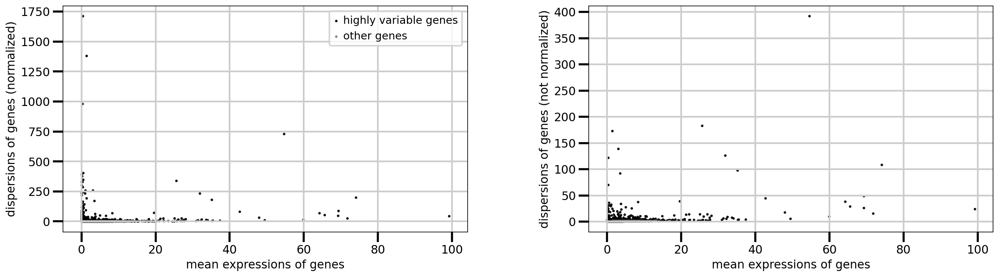

In [40]:
from matplotlib import rcParams

rcParams['figure.figsize']=(10,5)
sc.pl.highly_variable_genes(adata)

In [41]:
sc.pp.pca(adata, n_comps=20, use_highly_variable=False, svd_solver='arpack')
#sc.pl.pca_variance_ratio(adata)

computing PCA
    with n_comps=20
    finished (0:00:04)


In [42]:
### Dimentionality reduction examples using multiple techniques
sc.pp.pca(adata, n_comps=24, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)
sc.tl.tsne(adata) #Note n_jobs works for MulticoreTSNE, but not regular implementation)
sc.tl.umap(adata)
sc.tl.diffmap(adata)
sc.tl.draw_graph(adata)

computing PCA
    on highly variable genes
    with n_comps=24
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 24
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing tSNE
    using 'X_pca' with n_pcs = 24
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9857995  0.9697981  0.96745497 0.9626275  0.95797276
     0.95131516 0.93914866 0.9317501  0.929773   0.926775   0.91809803
     0.9048681  0.89653355 0.8861442 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata

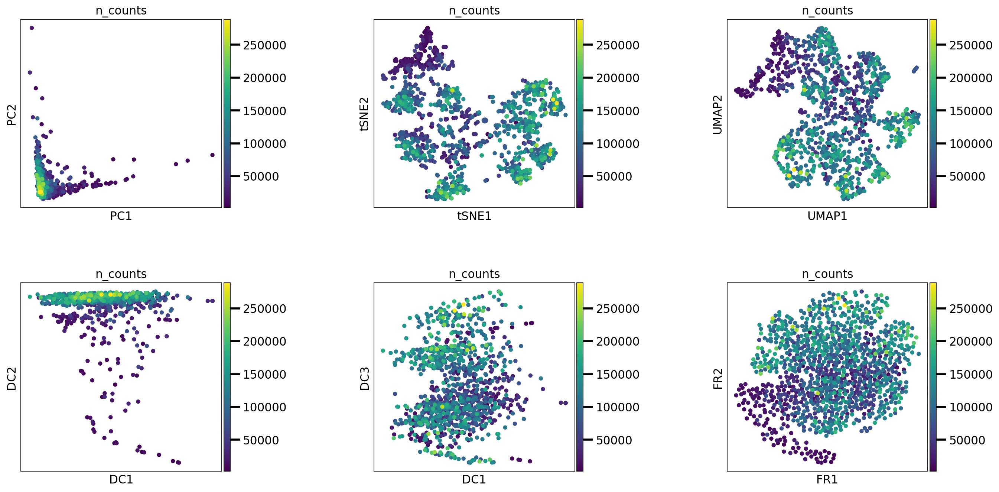

In [43]:
from matplotlib import rcParams


rcParams['figure.figsize']=(20,10)
fig_ind=np.arange(231, 237)
fig = plt.figure()
fig.subplots_adjust(hspace=0.4, wspace=0.6)

p10 = sc.pl.pca_scatter(adata, color='n_counts', ax=fig.add_subplot(fig_ind[0]), show=False)
p11 = sc.pl.tsne(adata, color='n_counts', ax=fig.add_subplot(fig_ind[1]), show=False)
p12 = sc.pl.umap(adata, color='n_counts', ax=fig.add_subplot(fig_ind[2]), show=False)
p13 = sc.pl.diffmap(adata, color='n_counts', components=['1,2'], ax=fig.add_subplot(fig_ind[3]),show=False)
p14 = sc.pl.diffmap(adata, color='n_counts', components=['1,3'], ax=fig.add_subplot(fig_ind[4]), show=False)
p15 = sc.pl.draw_graph(adata, color='n_counts', ax=fig.add_subplot(fig_ind[5]), show=False)

plt.show()

computing PCA
    on highly variable genes
    with n_comps=25
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 25
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)


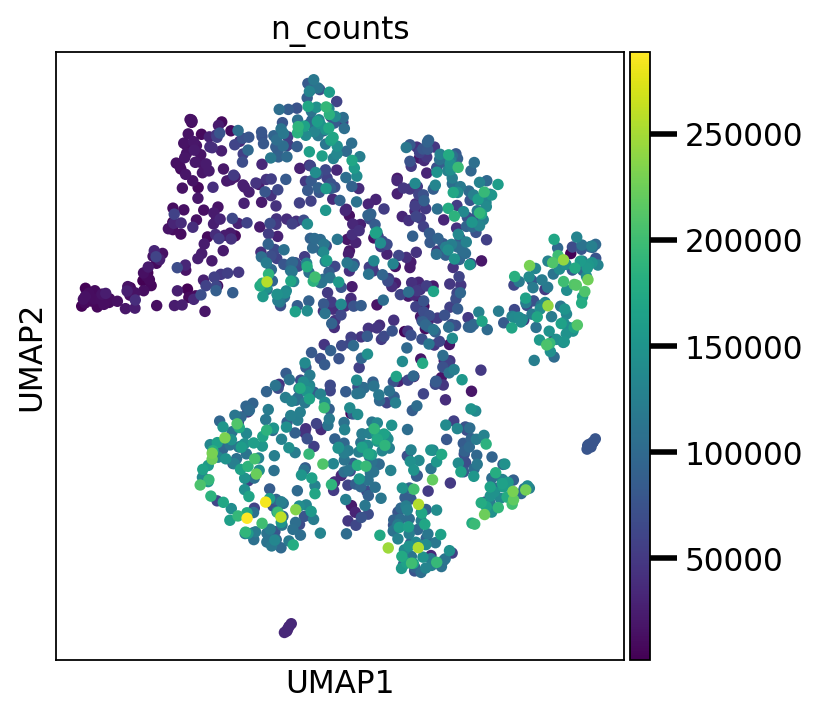

In [44]:
rcParams['figure.figsize']=(5,5)

for n in range(25,26):
    sc.pp.pca(adata, n_comps=n, use_highly_variable=True, svd_solver='arpack')
    sc.pp.neighbors(adata)
    sc.tl.umap(adata)
    sc.pl.umap(adata, color='n_counts', save = 'UMIs/pc_componets/pc_'+ str(n) + '.png')

computing PCA
    on highly variable genes
    with n_comps=25
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 25
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:01)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 34 clusters and added
    'louvain_r5', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 24 clusters and added
    'louvain_r3', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 18 clusters and added
    'louvain_r2', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    

/home/melma31/mambaforge/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


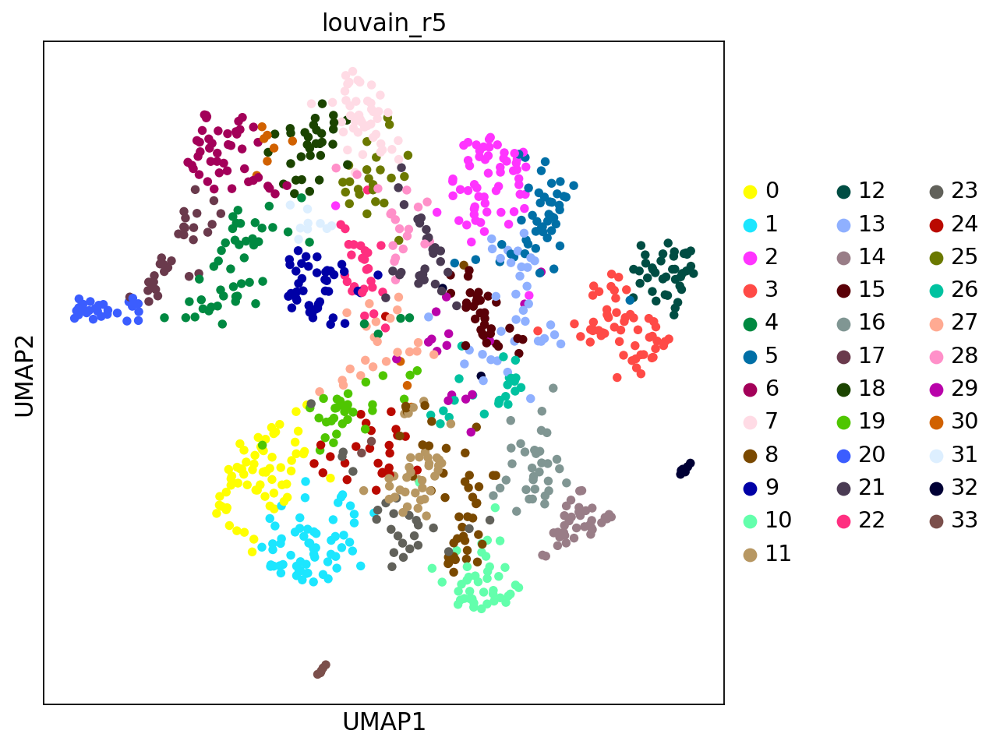

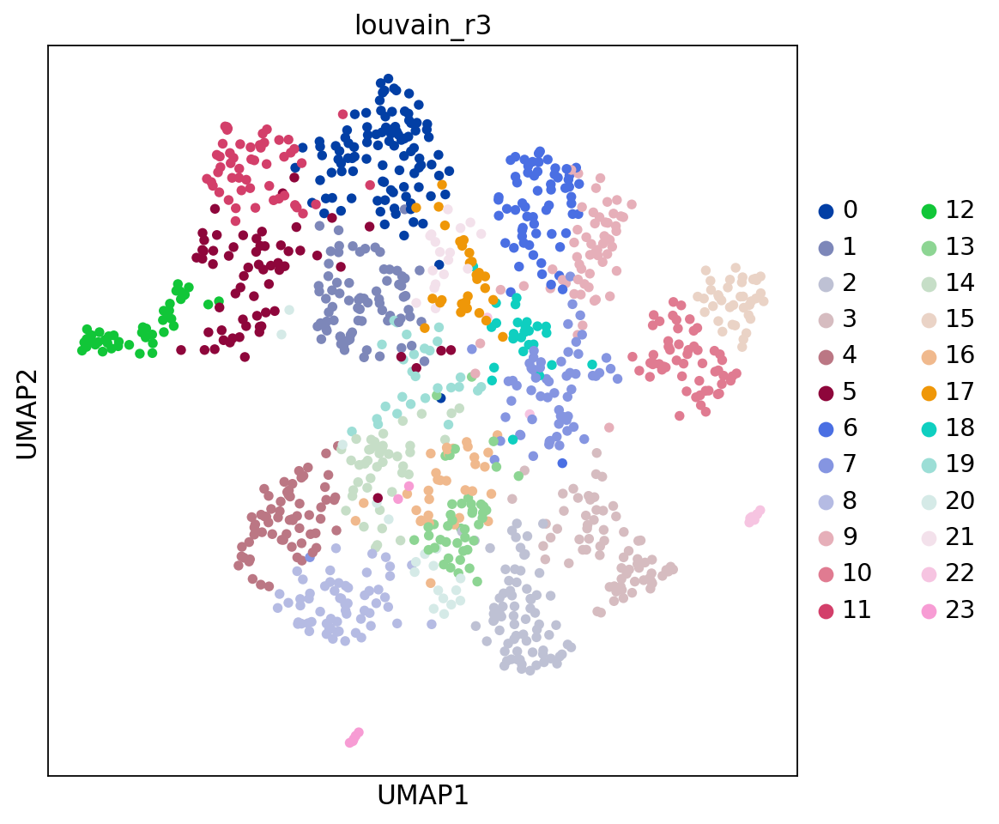

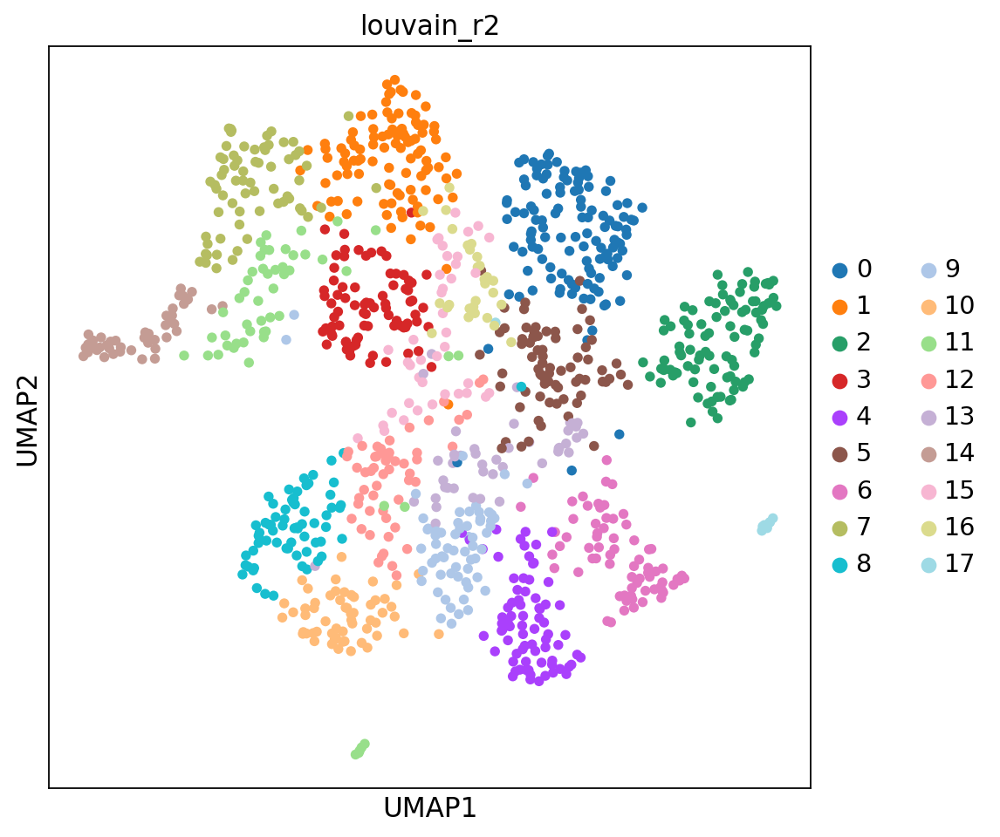

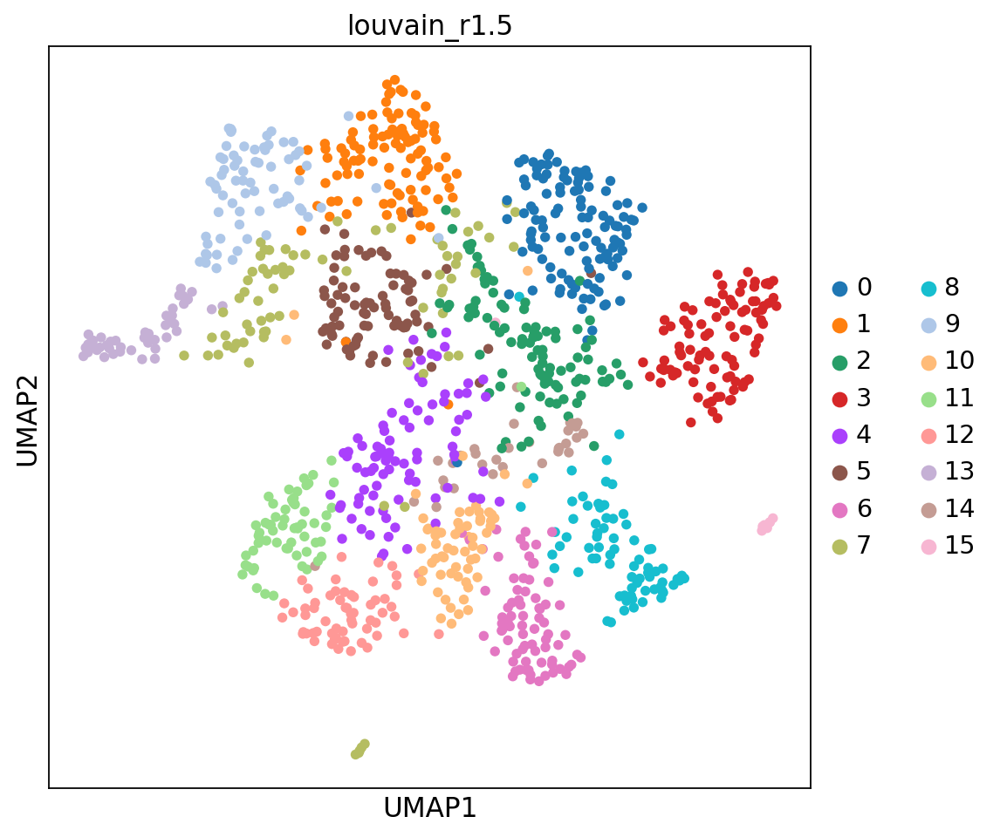

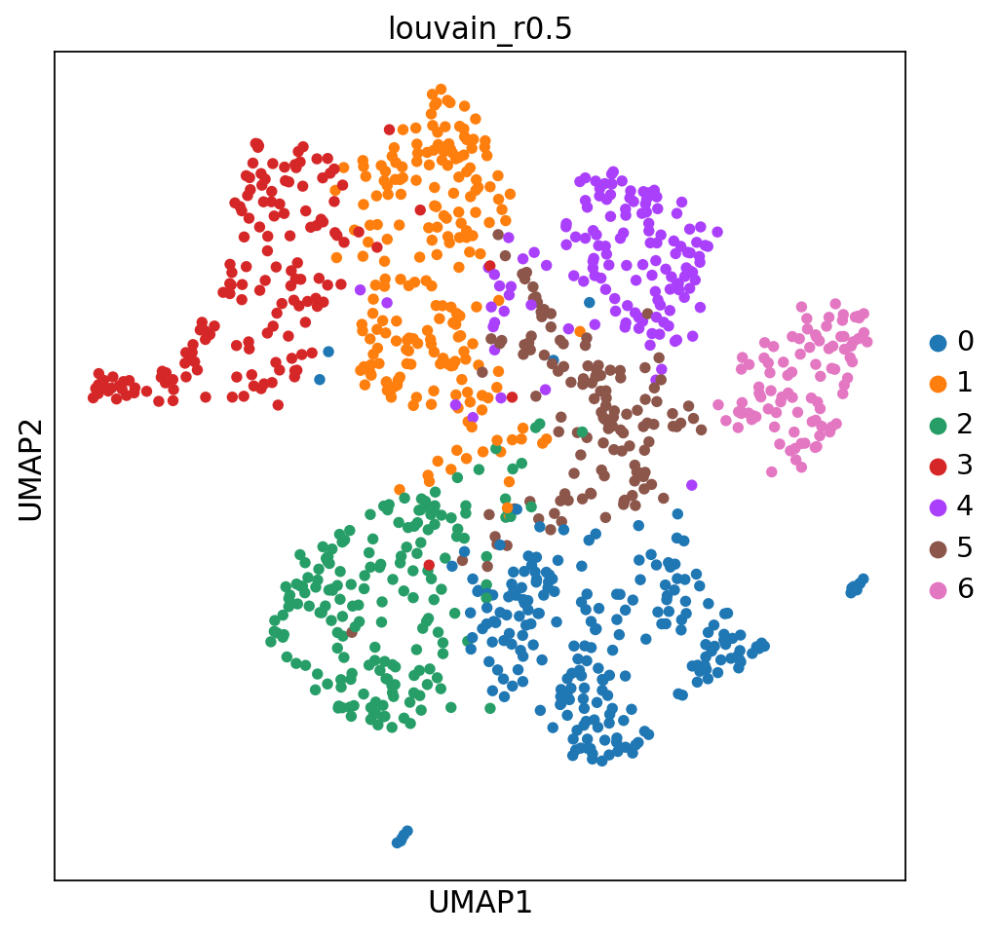

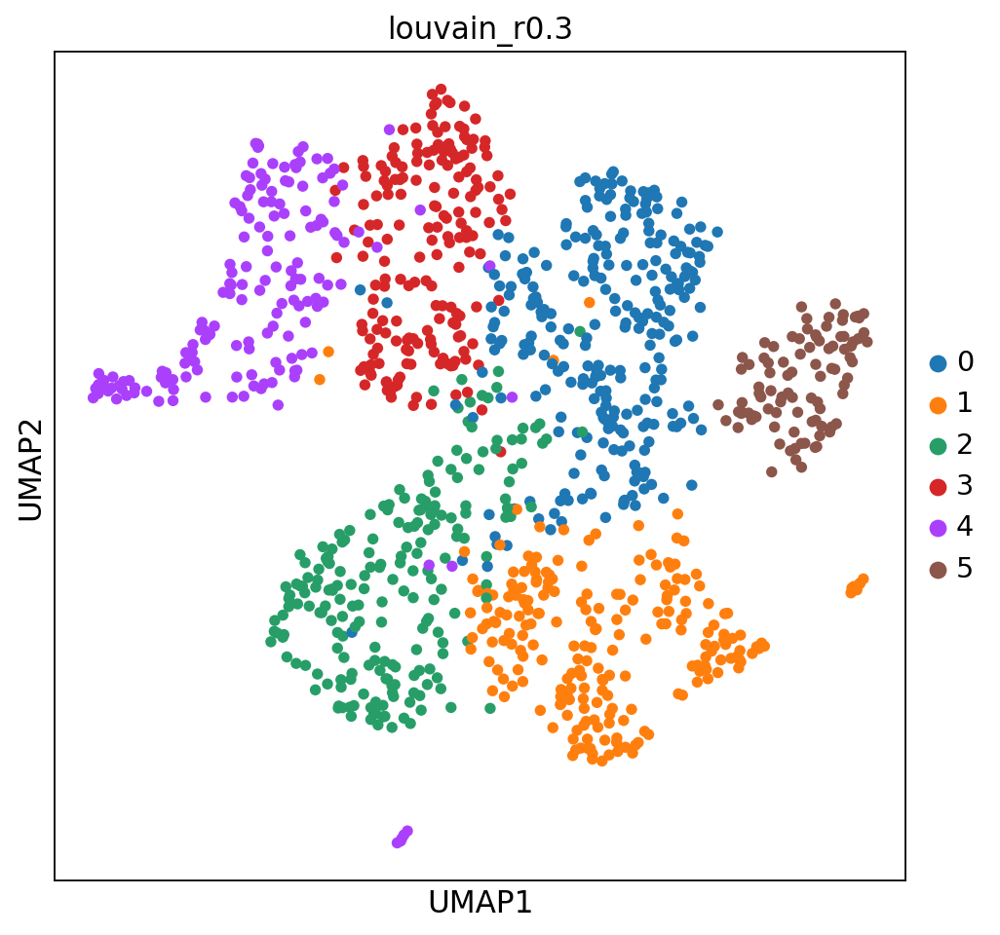

In [45]:
### Select one number of componets, for example n = 25 and do louvain in the umap transformation 
# with that number of componets

n=25
sc.pp.pca(adata, n_comps=n, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)
sc.tl.umap(adata)

# Perform clustering - using highly variable genes
sc.tl.louvain(adata, resolution=5, key_added='louvain_r5')
sc.tl.louvain(adata, resolution=3, key_added='louvain_r3')
sc.tl.louvain(adata, resolution=2, key_added='louvain_r2')
sc.tl.louvain(adata, resolution=1.5, key_added='louvain_r1.5')
sc.tl.louvain(adata, resolution=0.5, key_added='louvain_r0.5')
sc.tl.louvain(adata, resolution=0.3, key_added='louvain_r0.3')

rcParams['figure.figsize']=(7,7)

clustering_color = ['louvain_r5','louvain_r3','louvain_r2','louvain_r1.5', 'louvain_r0.5','louvain_r0.3']

#Visualize the clustering and how this is reflected by different technical covariates
for clustering in clustering_color:
    sc.pl.umap(adata, color=clustering, save = 'UMIs/louvain/'+clustering + '.png')
#sc.pl.umap(adata, color=['log_counts','stimuli'])

## SECTION IV: Genes exploration 

Here we explore the expression of relevant genes for the experiment. We use the umap projection created in section III and visualize the expresssion of interesting genes. 

In [46]:
### Define list of relevant genes 

marker_genes = ['Trpm3','Piezo2','Trpm2','Smr2','Sstr2','Bmpr1b','Trpm8','Trpv1','Piezo2','Piezo1','Nppb',
                'Sst','Pvalb','Prokr2','Mrgprd','Mrgpra3','Cd34',
                'Th','Trpa1','Ntrk3','Ntrk2','Ntrk1','Ret','Tac1','Calca','Calcb','Nefh',
                'S100b','Scn10a','Slc17a8','Atf3','Pou4f3','Calb1','Calb2','Avil','Asic3',
                'Asic2','Asic1','Pou6f2','Avpr1a','Pou4f2','Sox10','Casq2','Chrna7','Chrna3',
                'P2rx3','Gfsra2','Ldhb','Necab2','Spp1']


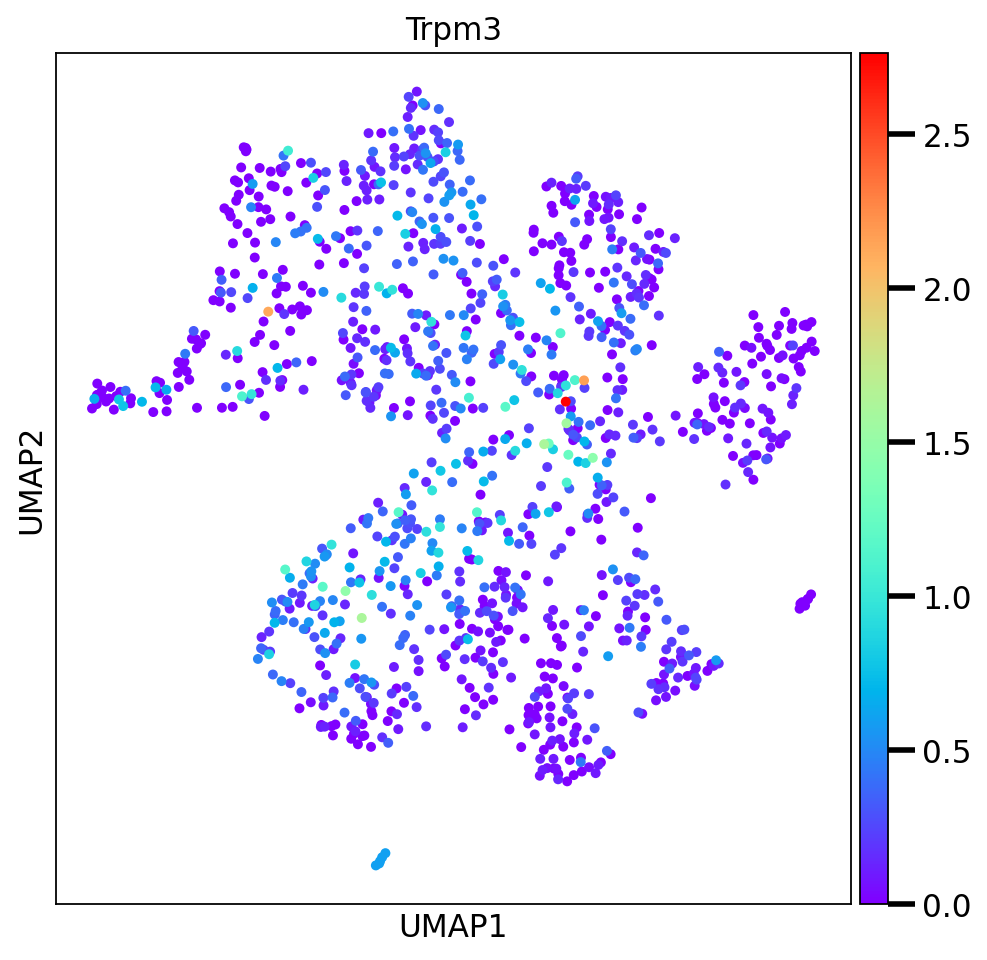

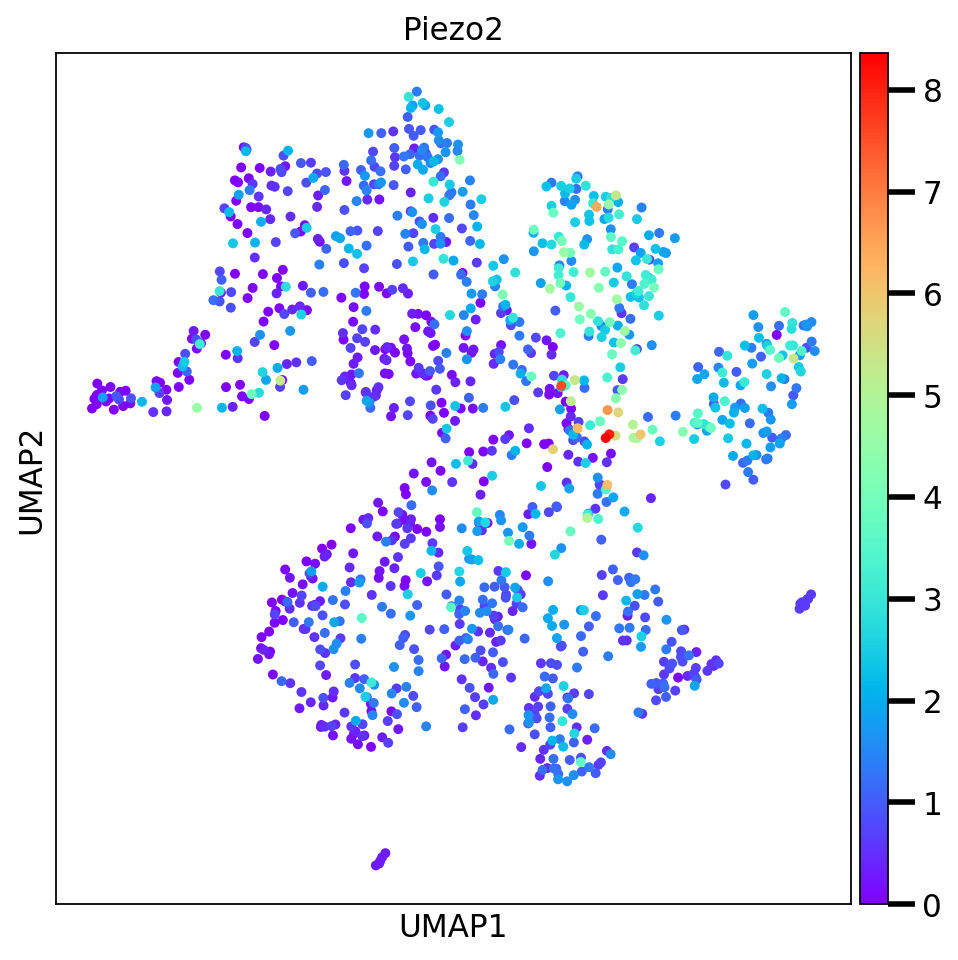

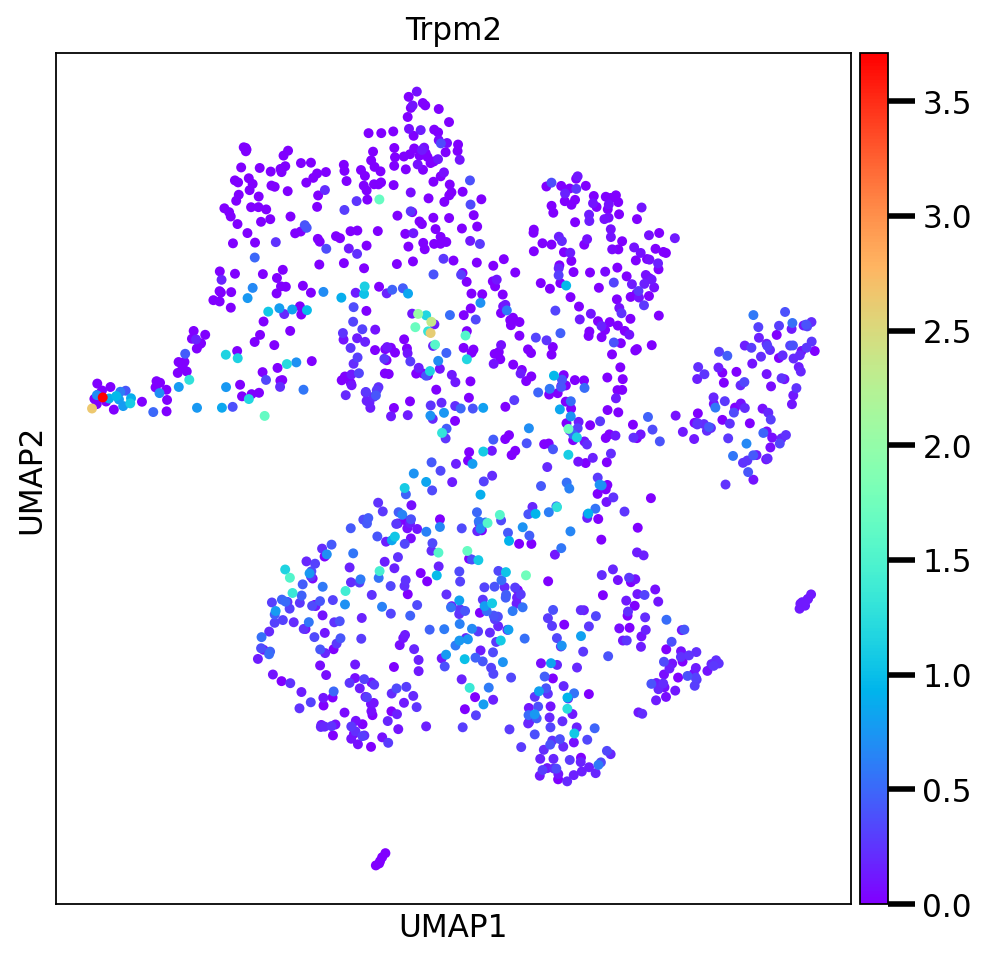

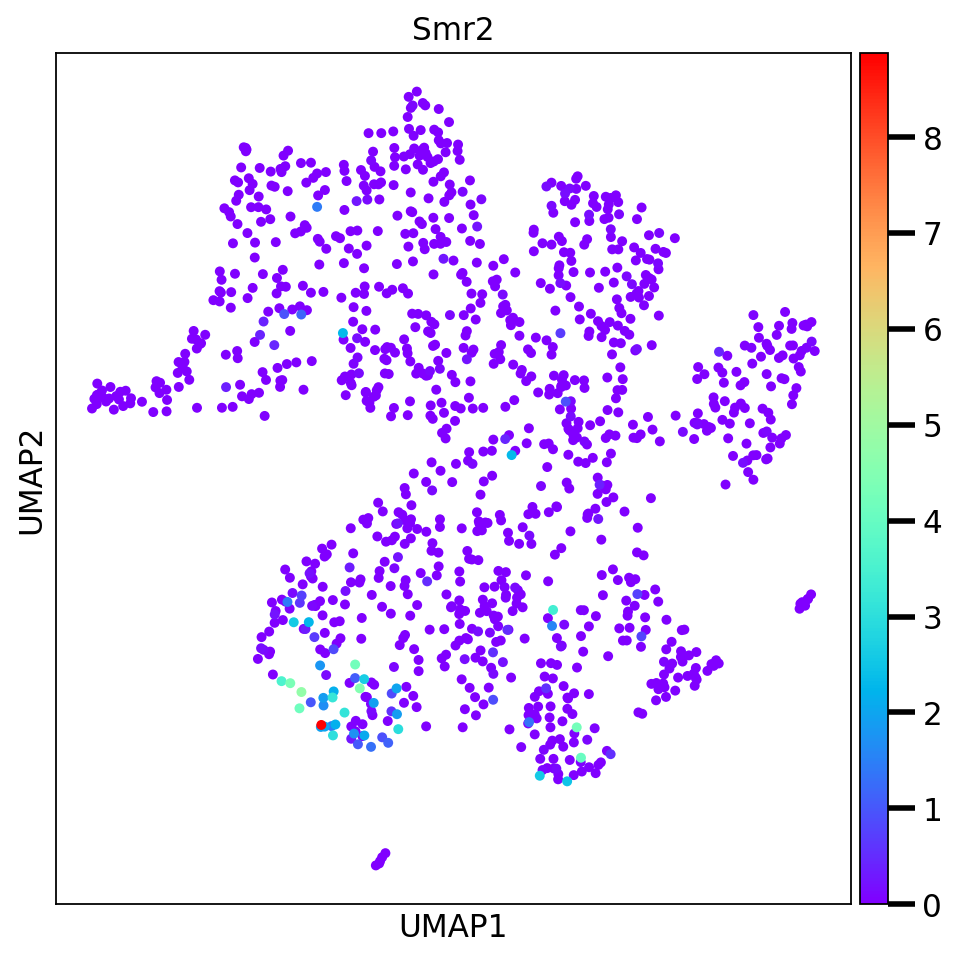

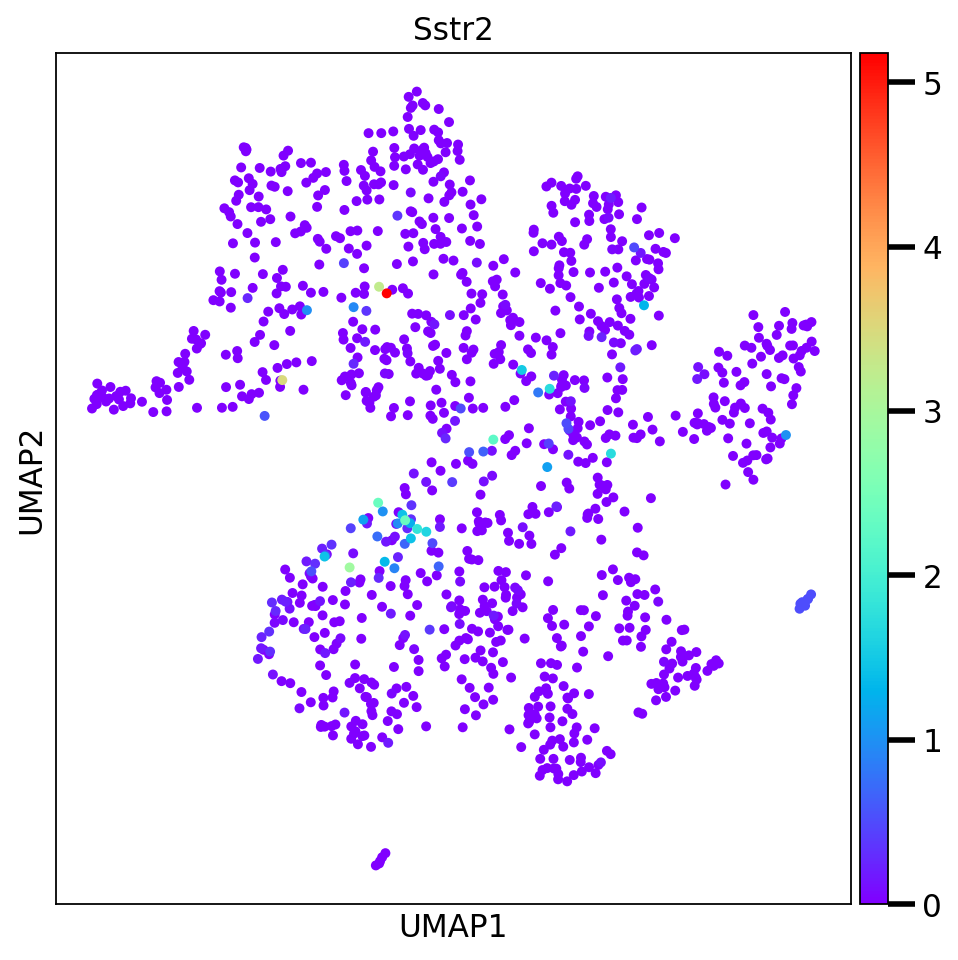

...

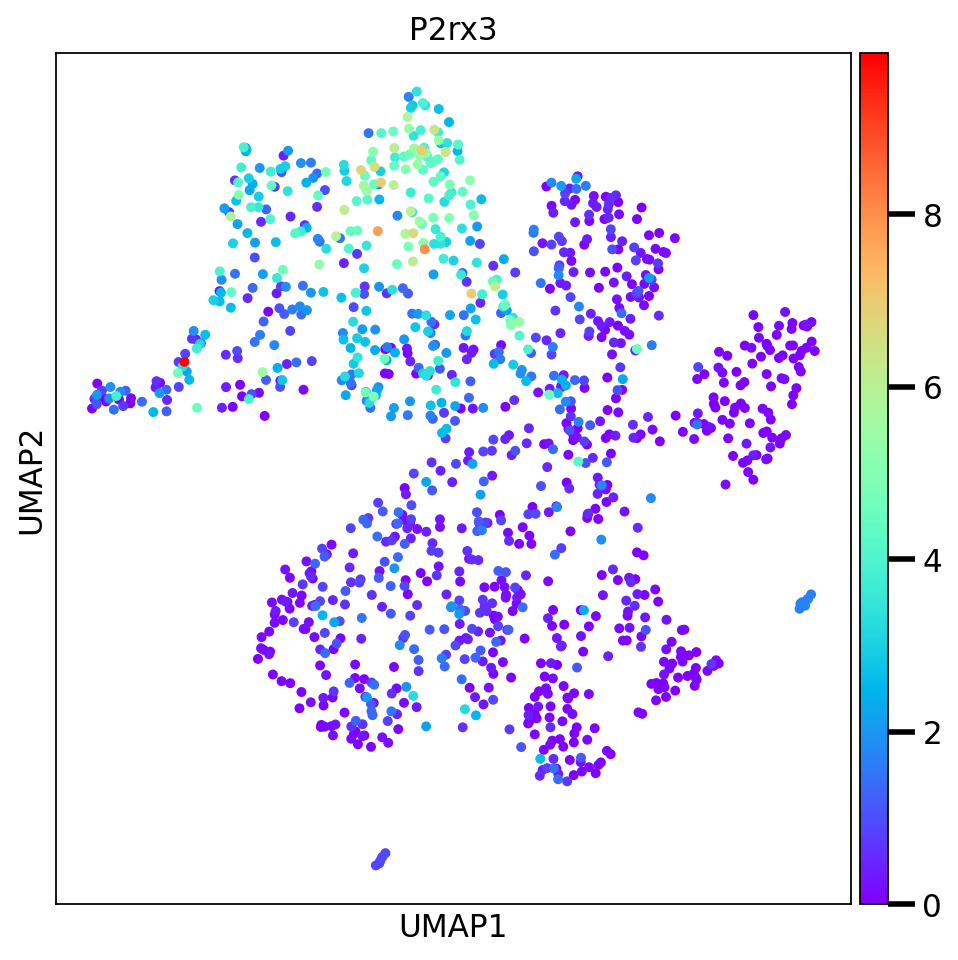

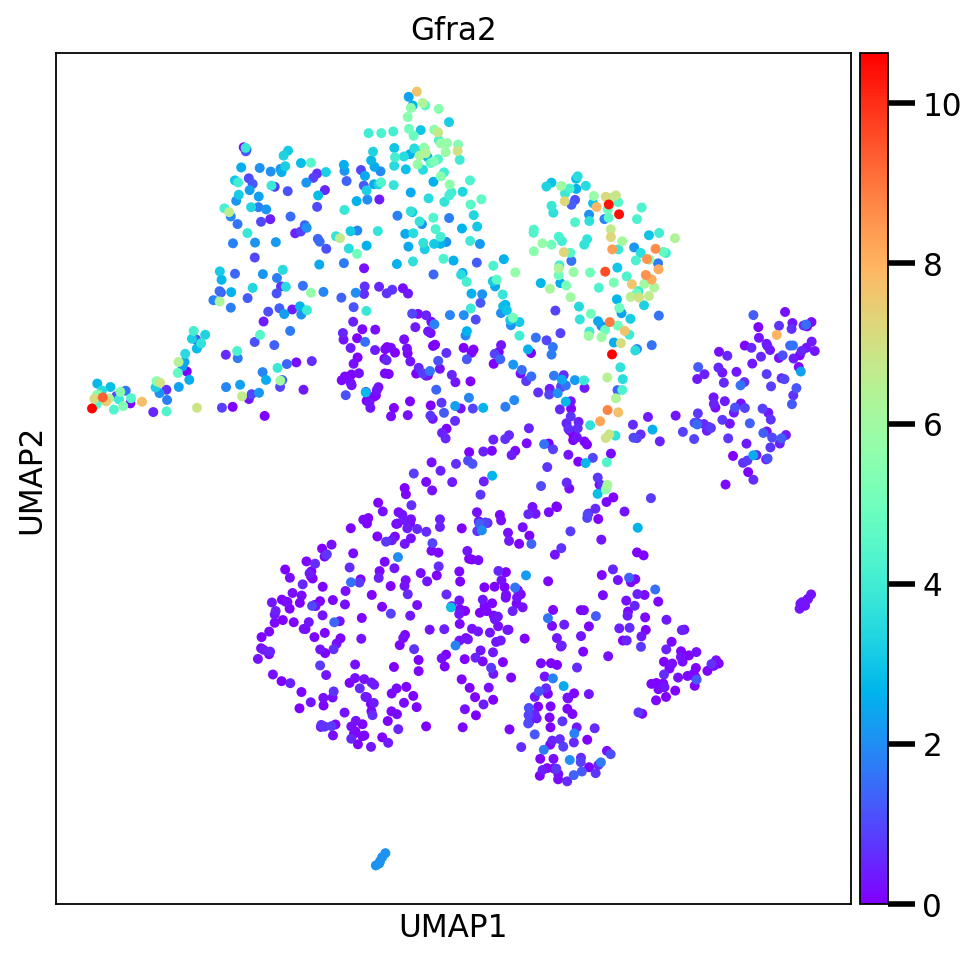

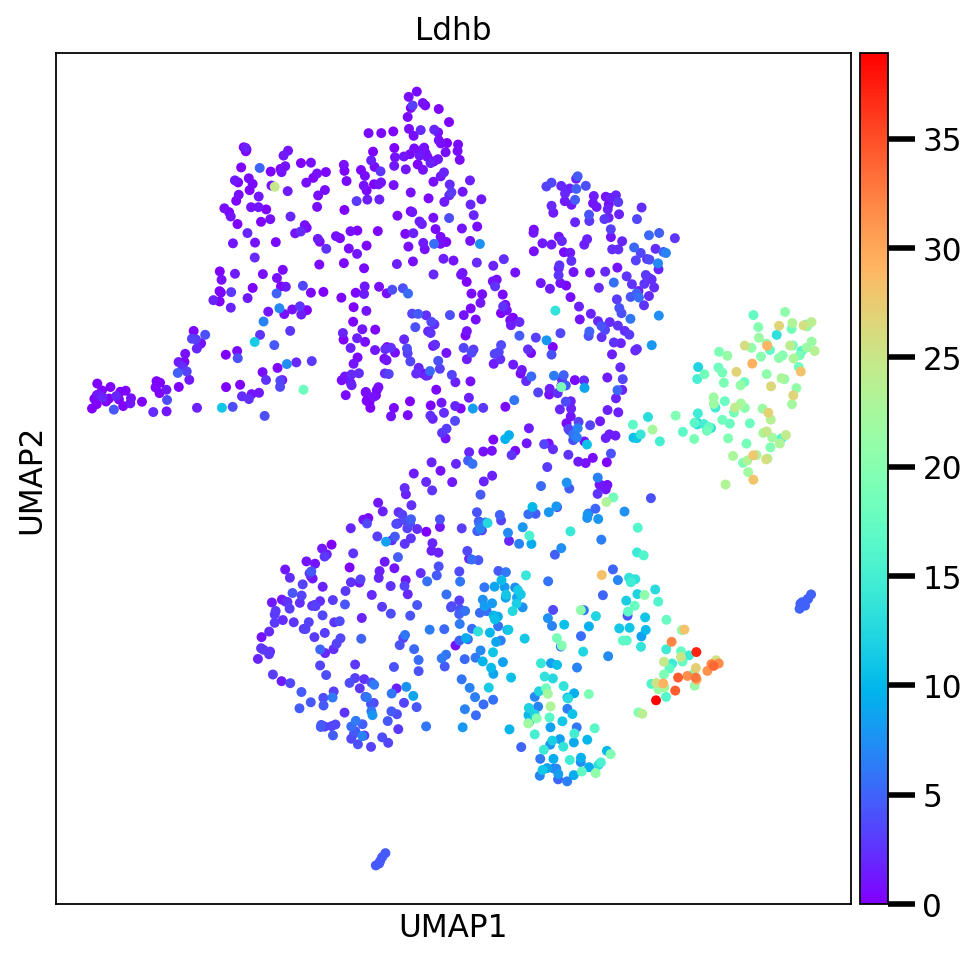

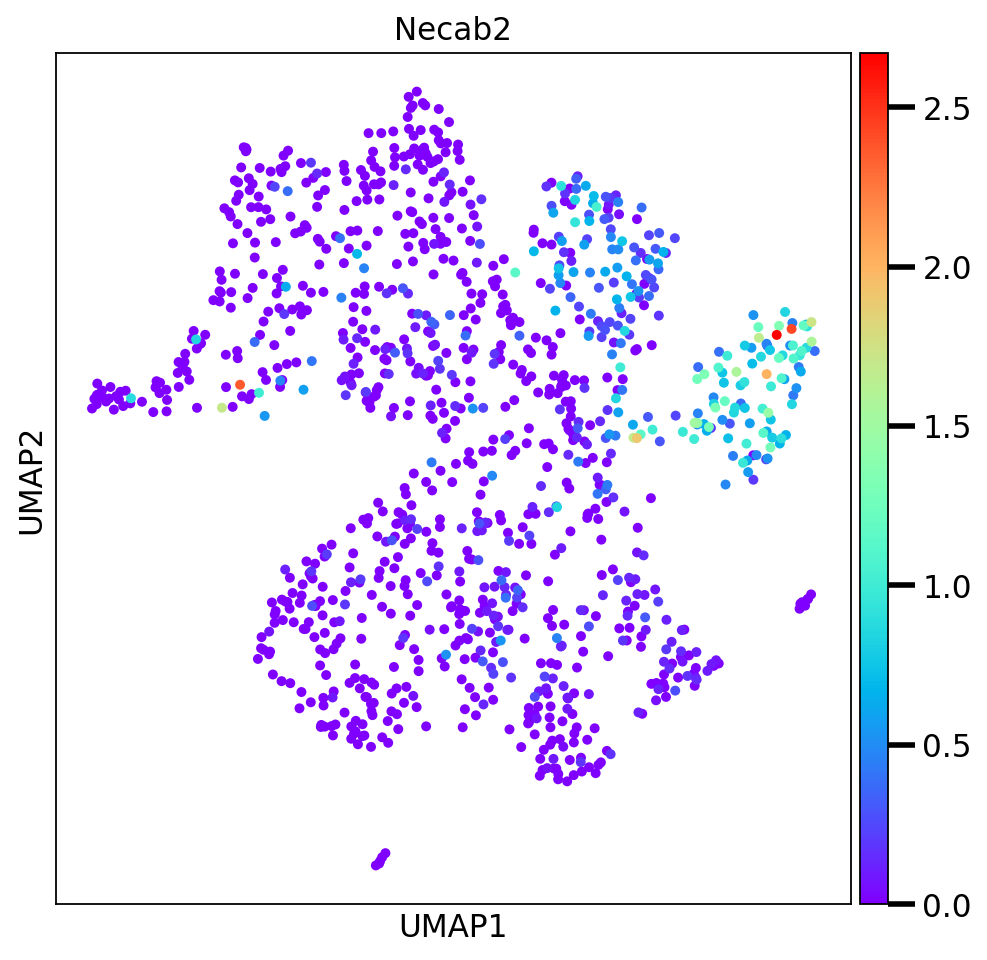

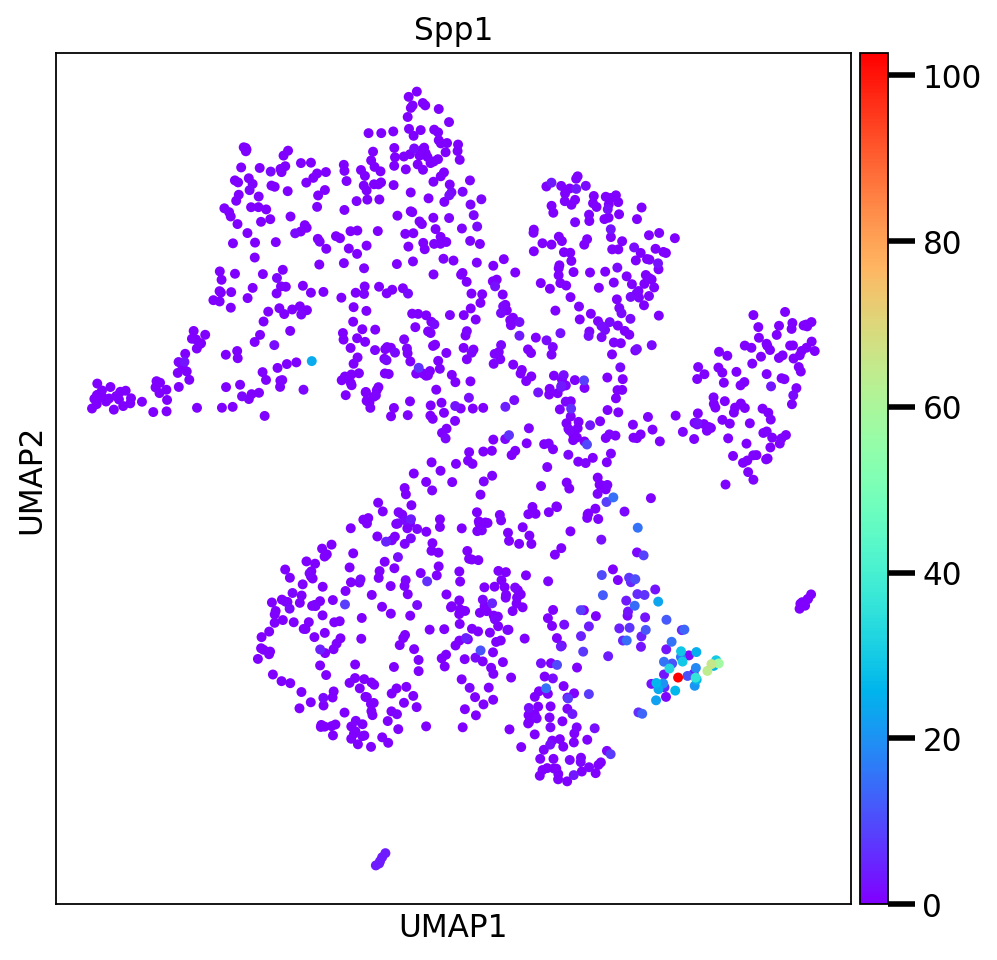

In [46]:
### Run plotting umap with color code according to gene expression
rcParams['figure.figsize']=(7,7)

np.in1d(marker_genes, adata.var_names)
for gene in marker_genes:
    sc.pl.umap(adata=adata, color=gene, use_raw=False, cmap = 'rainbow',save = 'UMIs/expression/genes_' + gene + '.png', size = 80)

## SECTION V: Funtional exploration

Now we add the information we have about stimuli for each cell and level of campari green and red fluorecence. 

Here we define the stimuli that were used (this assignation of number and id is the one that is used in the plate information excel sheet): 


* 0: control
* 1: pinch
* 2: new_stroke (after december)
* 3: ballon
* 4: AG (ano-genital brush)
* 5: AD (anal distension)
* 6: heating
* 7: mock
* 8: old_stoke (first experiments with stroke)
* 9: anal pinch
* 10: mock with poop
* 11: tomatoe
* 12: poop

In [52]:
#################################################################################
#################################################################################
#################################################################################
#################### HERE WE EXPORT ALL THE INFORMATION AS .MAT ################

### we export sparse data matrix, stimuli and flourecence information, umap transformation information and
### louvain transformation

### create and exportable varable list of genes names
gene_name = []
for i in range(len(adata.var['gene_name'])):
    gene_name.append(adata.var['gene_name'].iloc[i])
### transform adata sparse matrix to scipy
x = scipy.sparse.csr_matrix.toarray(adata.X)

### create exportable arrays with information about stimuli, fluorecence, and louvain transformations
stim = np.zeros((x.shape[0],))
red = np.zeros((x.shape[0],))
green = np.zeros((x.shape[0],))
louvain = np.zeros((x.shape[0],6))

for i in range(x.shape[0]):
    stim[i] = adata.obs['stimulus'][i]
    red[i] = adata.obs['red'][i]
    green[i] = adata.obs['green'][i]
    louvain[i,0] = adata.obs['louvain_r0.3'][i]
    louvain[i,1] = adata.obs['louvain_r0.5'][i]
    louvain[i,2] = adata.obs['louvain_r1.5'][i]
    louvain[i,3] = adata.obs['louvain_r2'][i]
    louvain[i,4] = adata.obs['louvain_r3'][i]
    louvain[i,5] = adata.obs['louvain_r5'][i]
   
    
data = {'umap': adata.obsm['X_umap'],'gene_name' : np.array(gene_name),'sparse_matrix': x,'stimuli':stim,
        'red_intesity': red, 'green_intensity': green, 'louvain' : louvain}

scipy.io.savemat(figure_path + 'plate_123.mat', data)

#################################################################################
#################################################################################
#################################################################################

25930


In [56]:
rcParams['figure.figsize']=(4,4)

labels=['Control','pinch','new_stroke','ballon','AG','AD','heating','mock','old_stroke','anal_pinch','mock_w_poop','vaginal_distension','tomatoe','poop']
color = ['gainsboro','green','darkorange','purple','magenta','cyan','red','orange','yellow','brown','orange','blue','violet','k']

x = scipy.sparse.csr_matrix.toarray(adata.X)
stim = np.zeros((x.shape[0],))
red = np.zeros((x.shape[0],))
green = np.zeros((x.shape[0],))
for i in range(x.shape[0]):
    stim[i] = adata.obs['stimulus'][i]
    red[i] = adata.obs['red'][i]
    green[i] = adata.obs['green'][i]
    

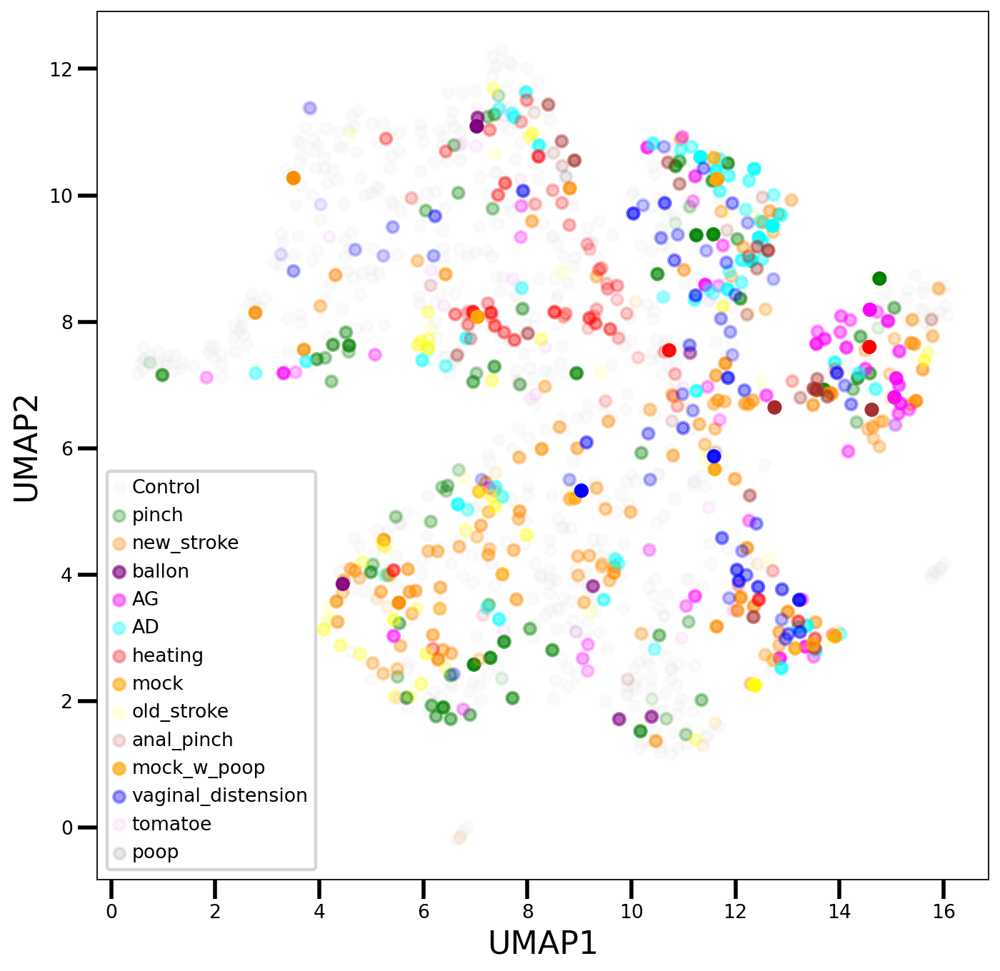

In [57]:
### plotting all stimulus together

figure, axes = plt.subplots()
#red_norm = (red - np.min(red)) / (np.max(red) - np.min(red))
for i in range(len(labels)):
    index = np.where(stim == i)[0]
    red_norm = (red[index] - np.min(red[index])) / (np.max(red[index]) - np.min(red[index]) + sys.float_info.epsilon)
    red_norm = (red_norm + 0.1)/1.1
    axes.scatter(adata.obsm['X_umap'][index,0],adata.obsm['X_umap'][index,1], s = 50, c = color[i], alpha = red_norm)
axes.grid(visible = 'None')
#axes.set_xlim([0,19])
#axes.set_ylim([0,19])
axes.set_xlabel('UMAP1', fontsize = 20)
axes.set_ylabel('UMAP2', fontsize = 20)
axes.tick_params(axis='both', which='major', labelsize=12)
axes.tick_params(axis='both', which='minor', labelsize=12)
axes.grid(False)

axes.legend(labels, fontsize = 12)
#sc.pl.umap(adata, color = 'stimulus', color_map = 'Set1', save = 'stimulus'+ '.png', size = 180)
figure.set_size_inches([10,10])
figure.savefig(figure_path + 'stimulus.png')

(629, 25930)


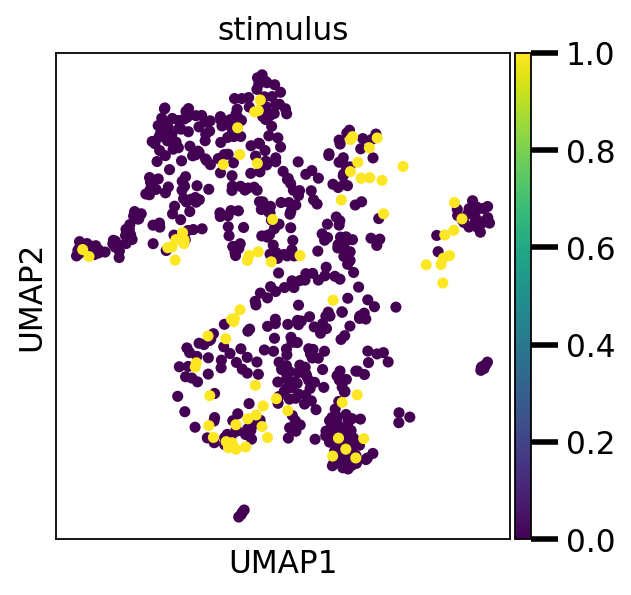

(686, 25930)


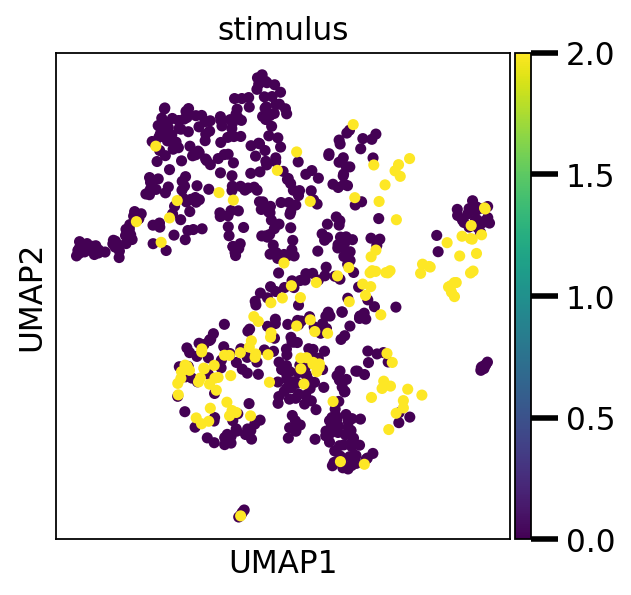

(561, 25930)


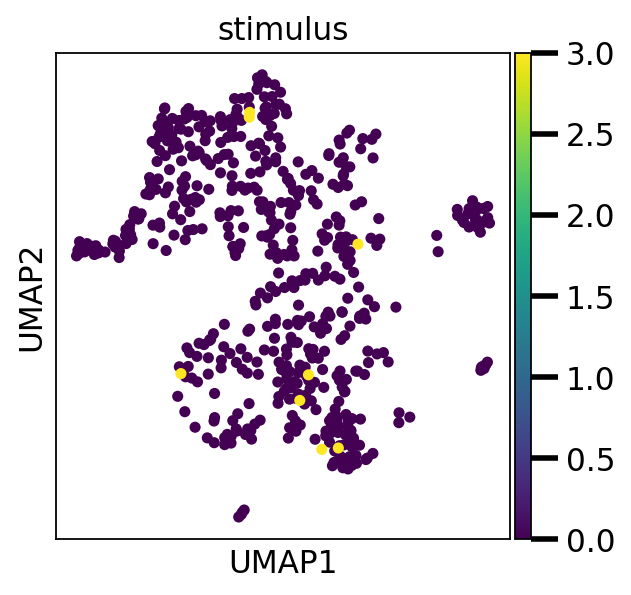

(604, 25930)


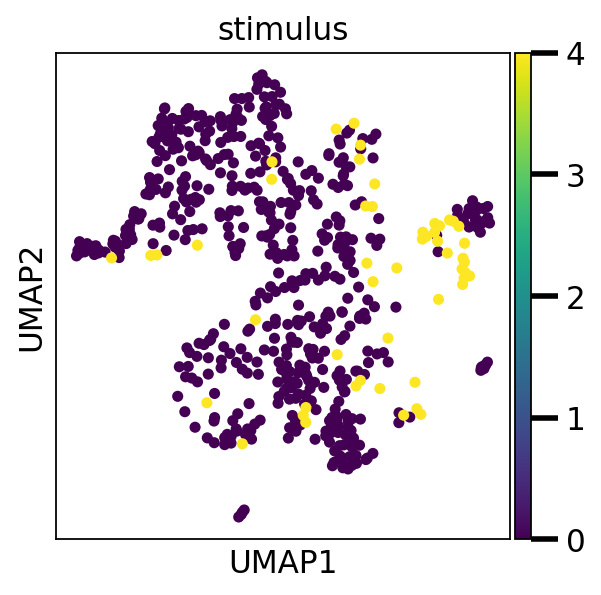

(614, 25930)


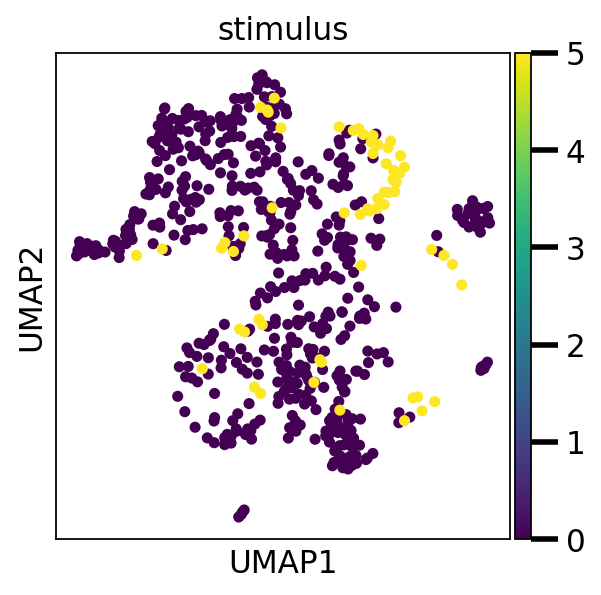

(616, 25930)


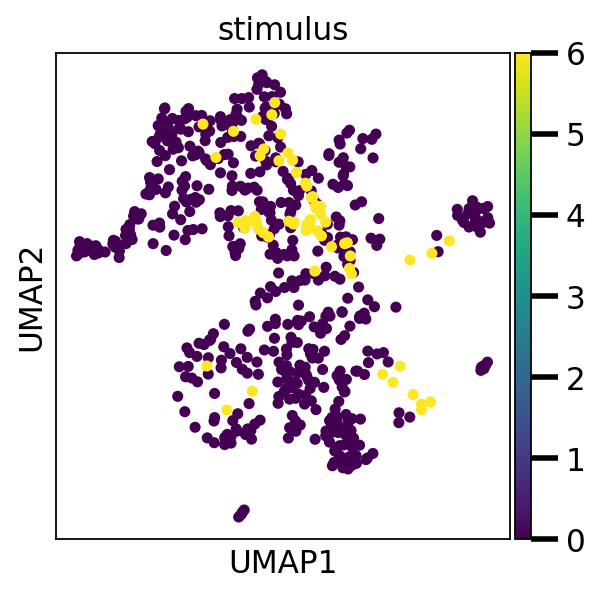

(569, 25930)


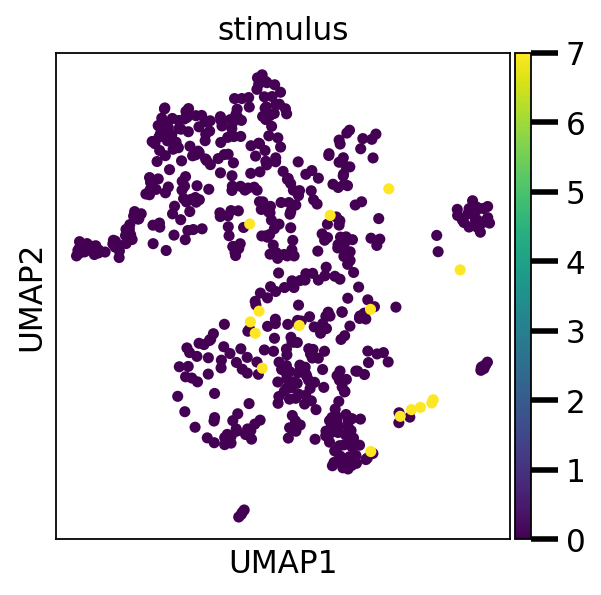

(608, 25930)


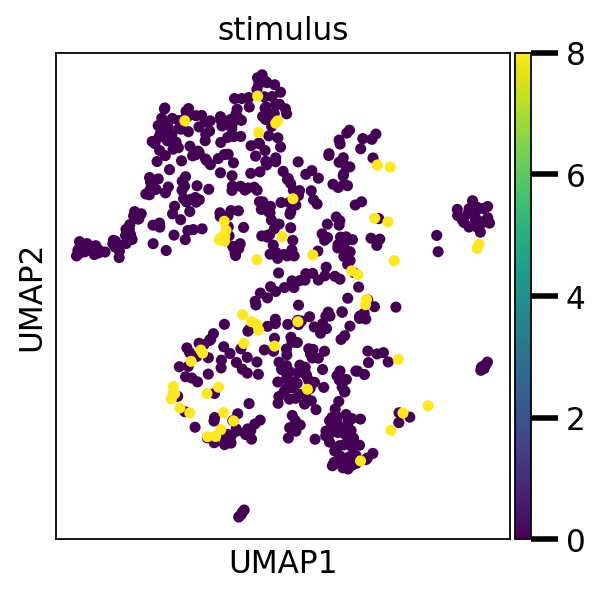

(585, 25930)


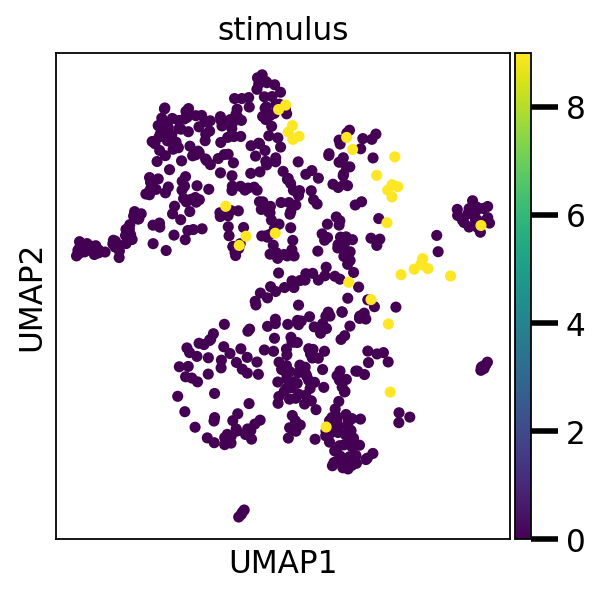

(557, 25930)


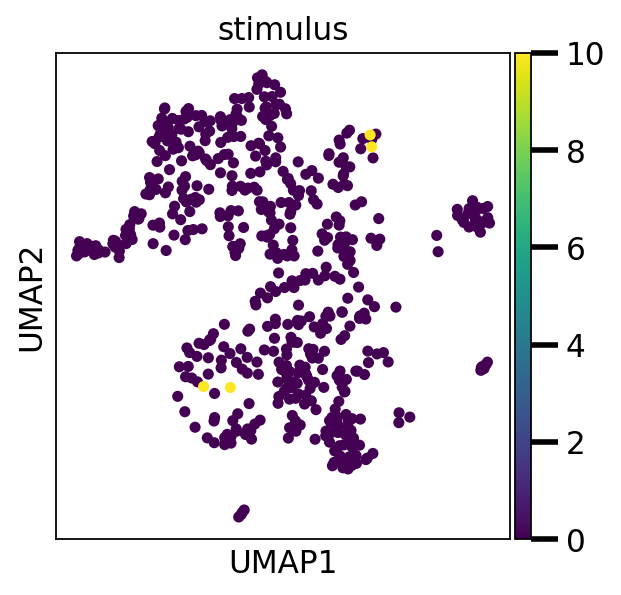

(612, 25930)


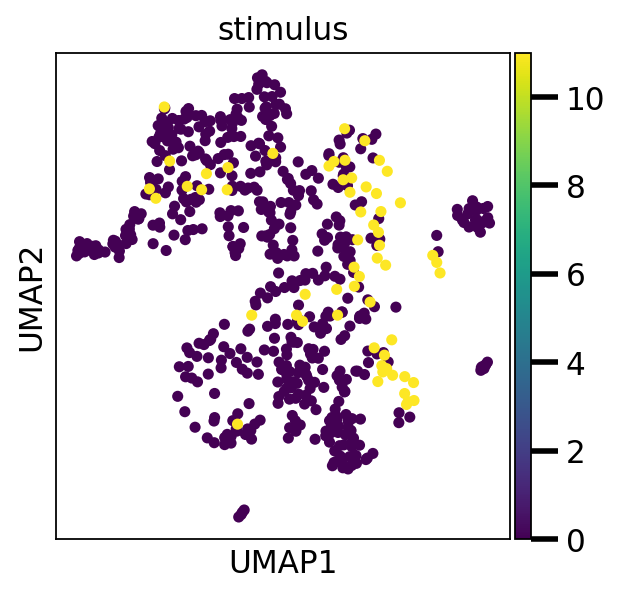

(575, 25930)


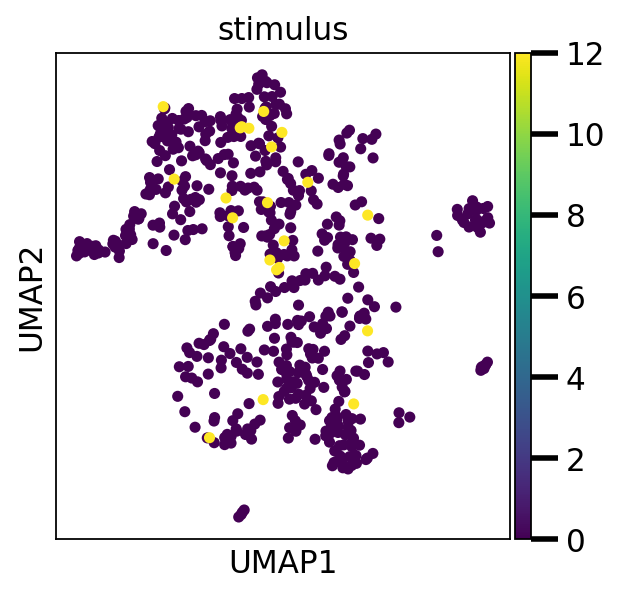

(554, 25930)


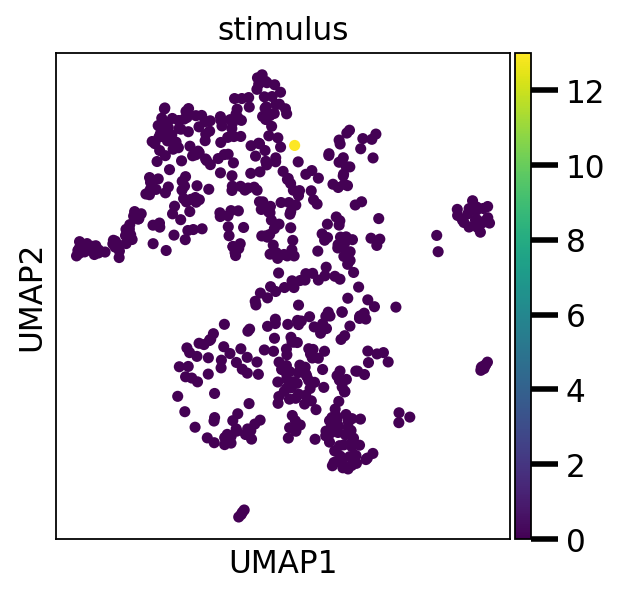

In [66]:
### plotting stimuli individualy

rcParams['figure.figsize']=(4,4)

for i in range(1,14):
    index = np.logical_or(adata.obs['stimulus'] == i,adata.obs['stimulus'] == 0)
    aux_adata = adata[index,:]
    print(aux_adata.shape)
    sc.pl.umap(aux_adata, color = 'stimulus', color_map = 'viridis', save = 'UMIs/stimulus/stimulus_' + labels[i]+ '.png', size = 100)

0
[]
4
[0]
5
[0, 4]
2
[0, 4, 5]
1
[0, 4, 5, 2]
9
[0, 4, 5, 2, 1]
6
[0, 4, 5, 2, 1, 9]
11
[0, 4, 5, 2, 1, 9, 6]
12
[0, 4, 5, 2, 1, 9, 6, 11]


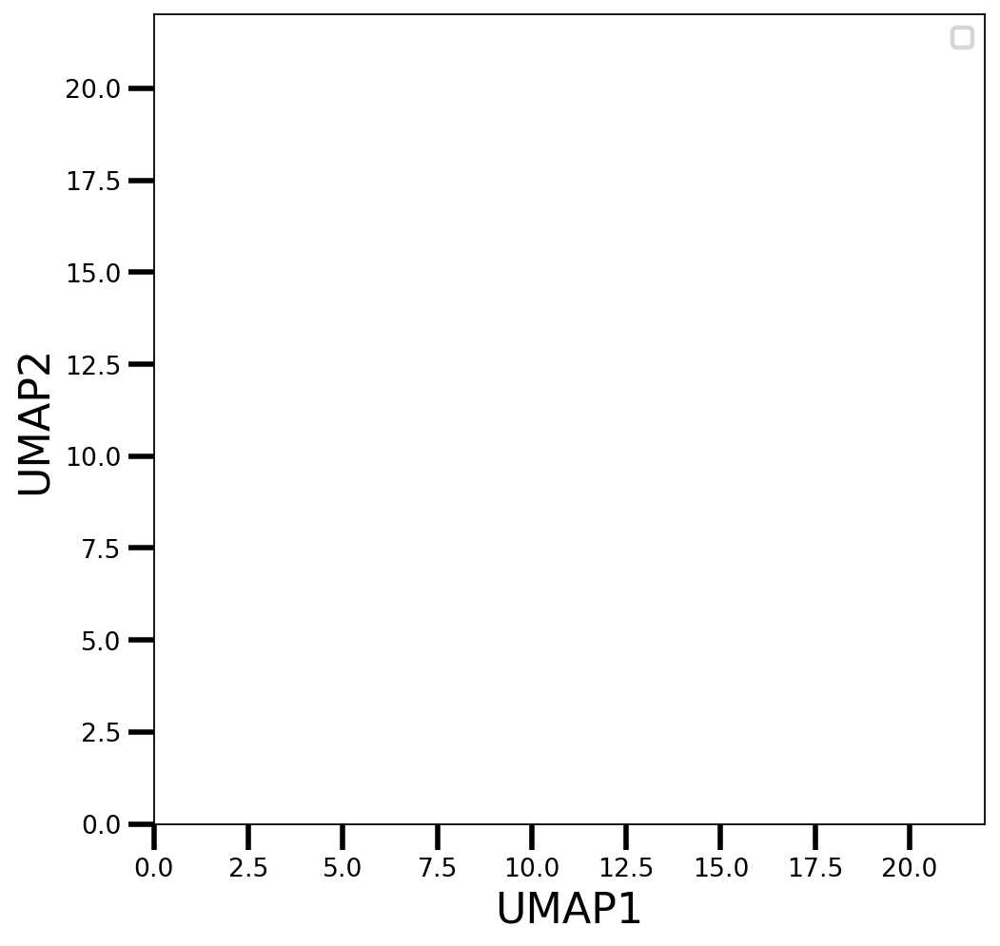

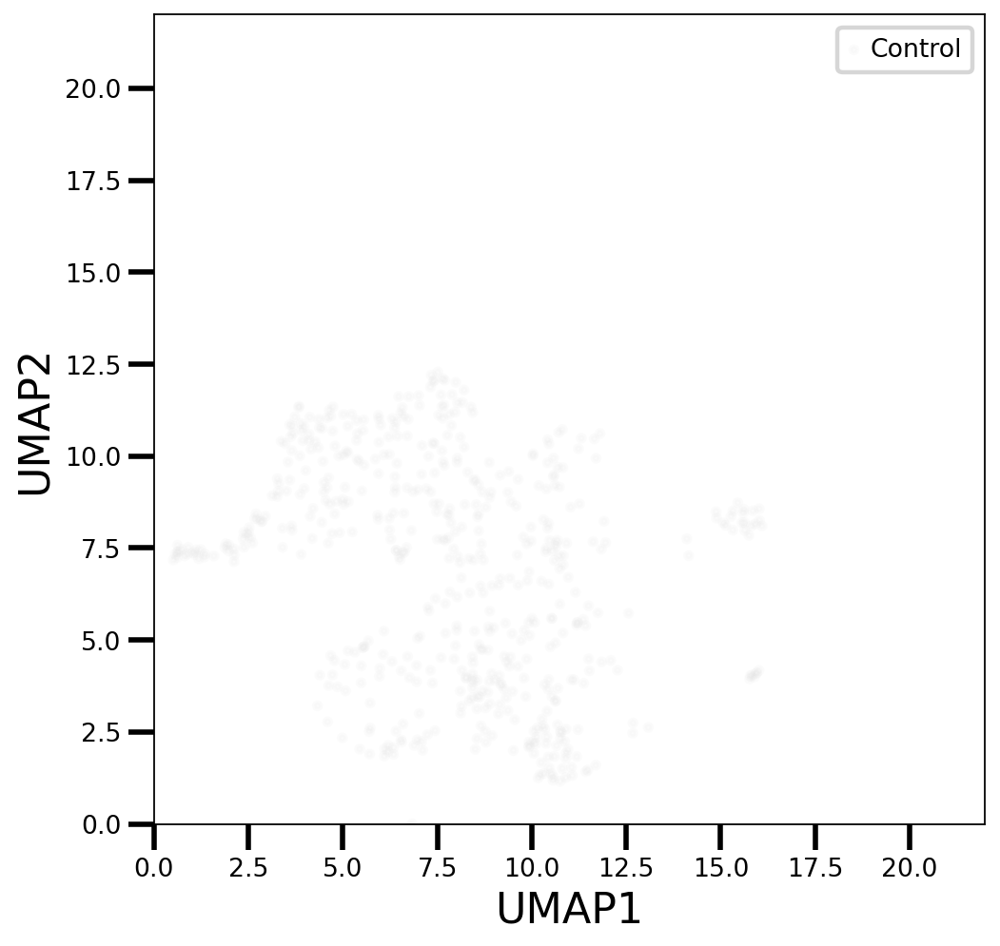

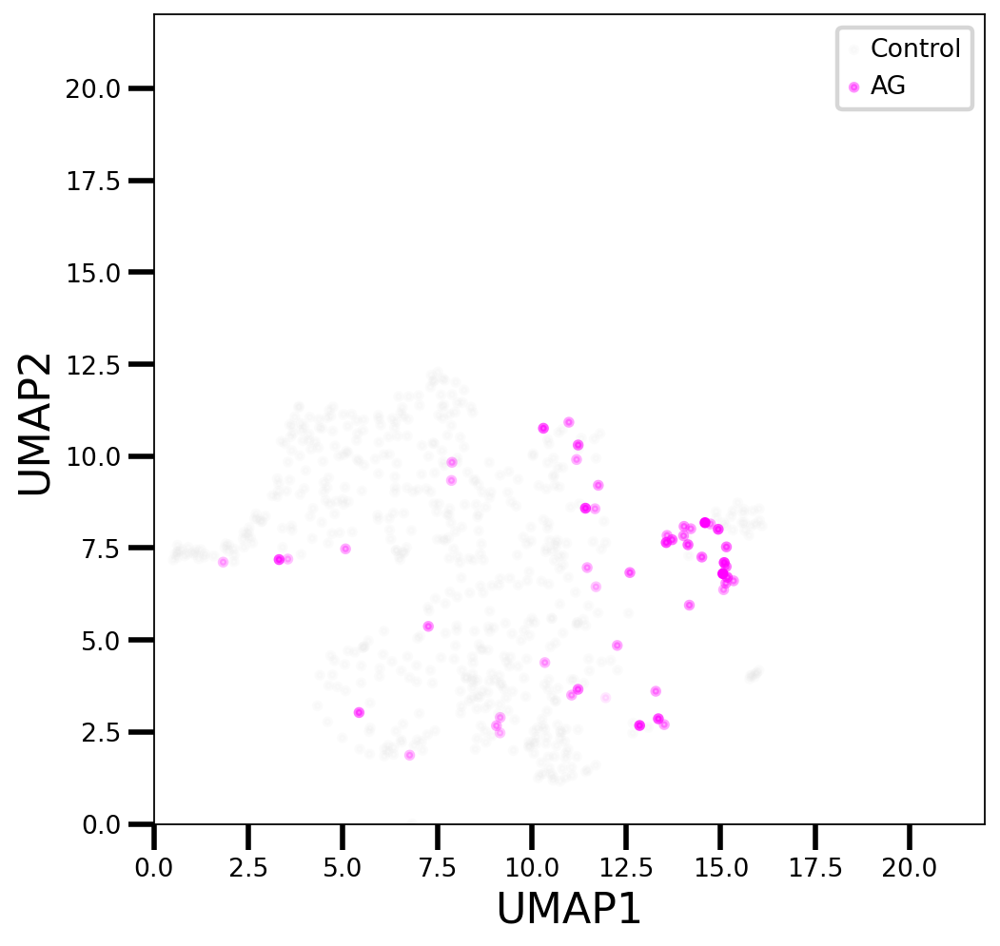

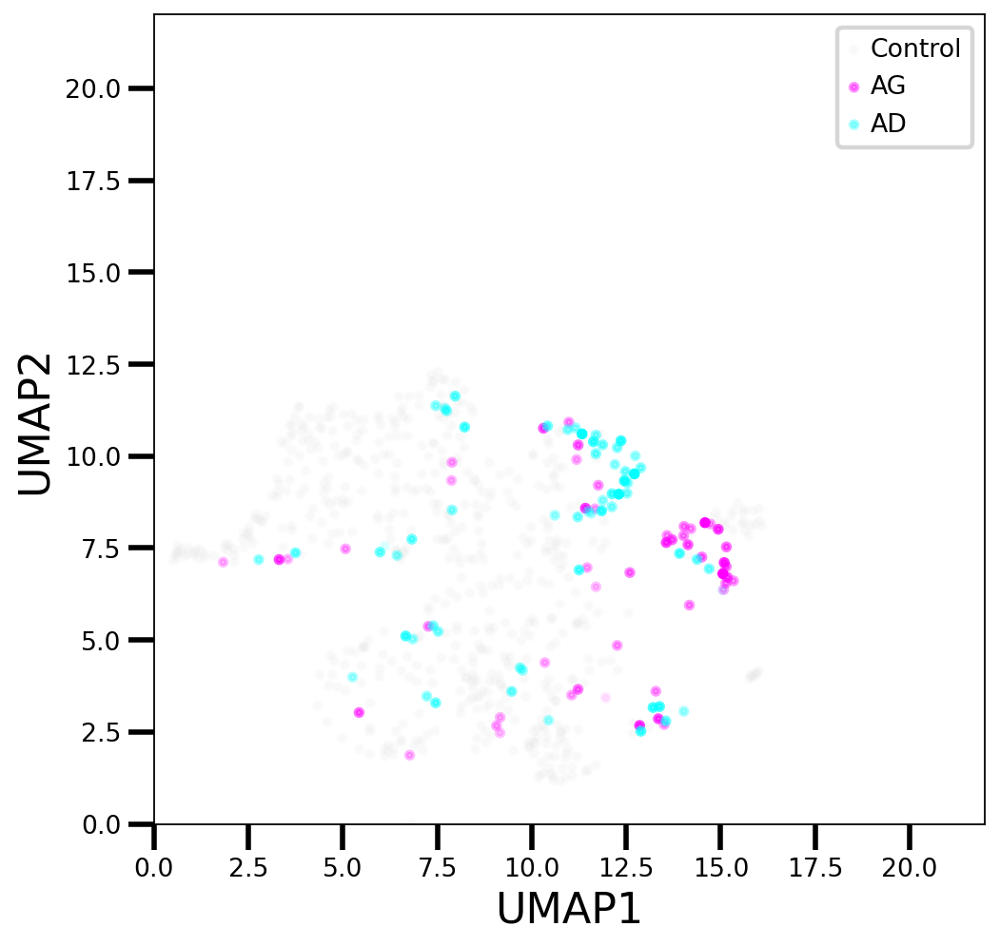

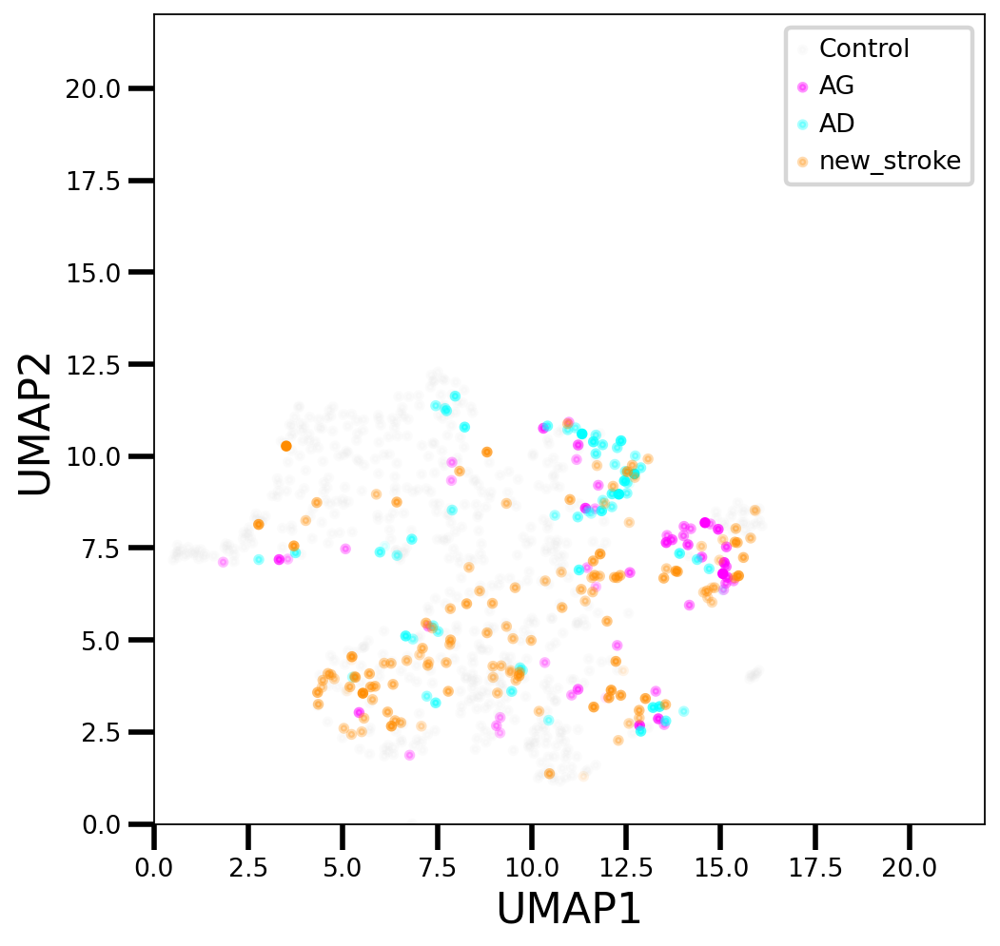

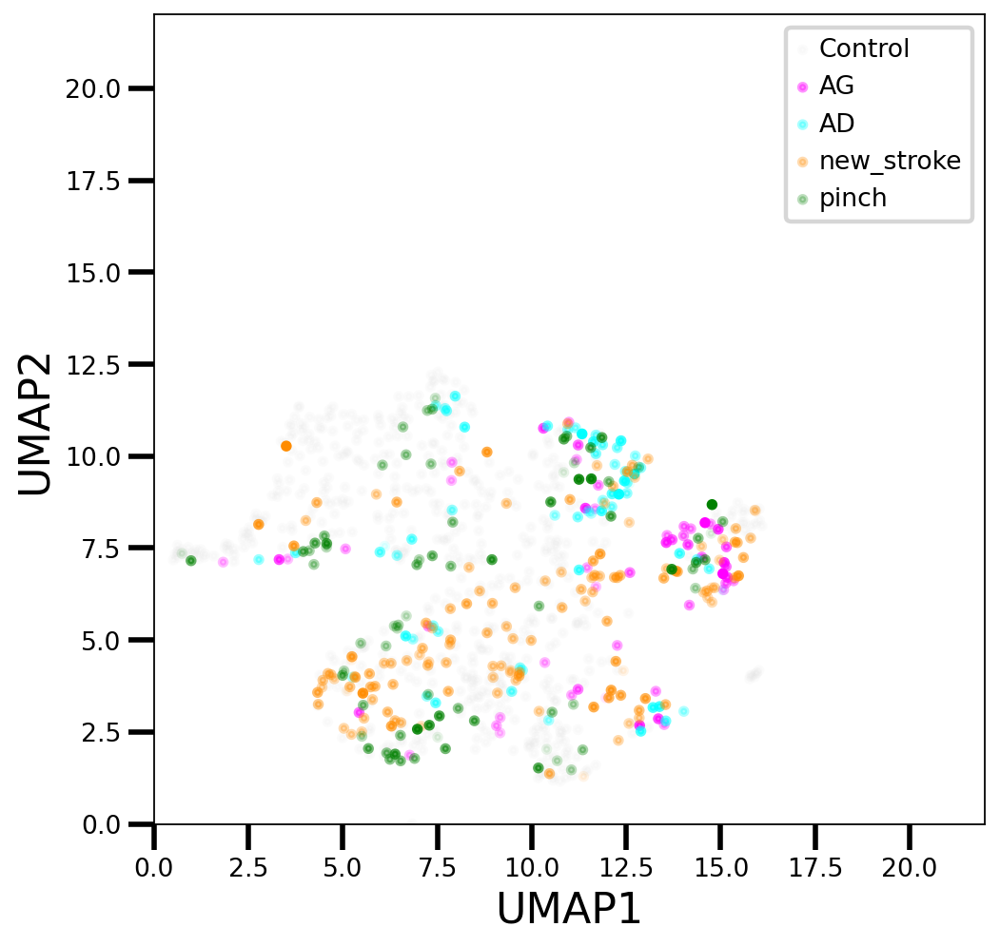

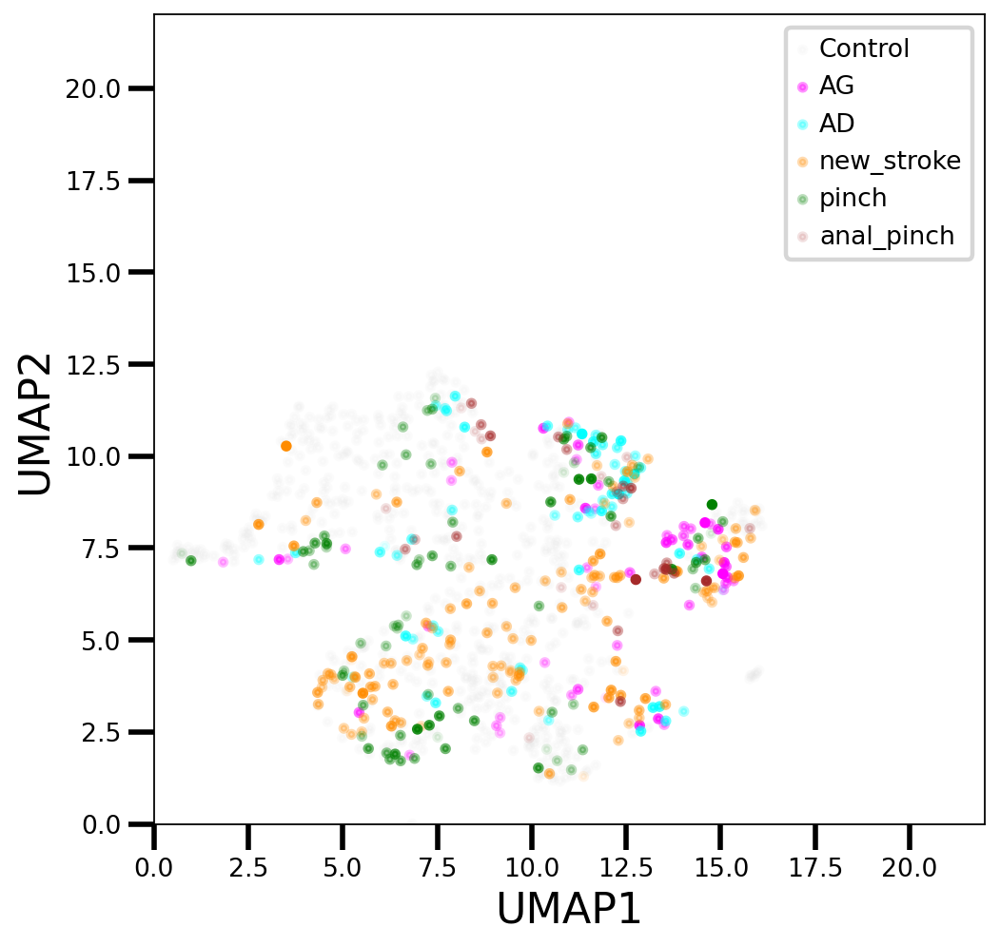

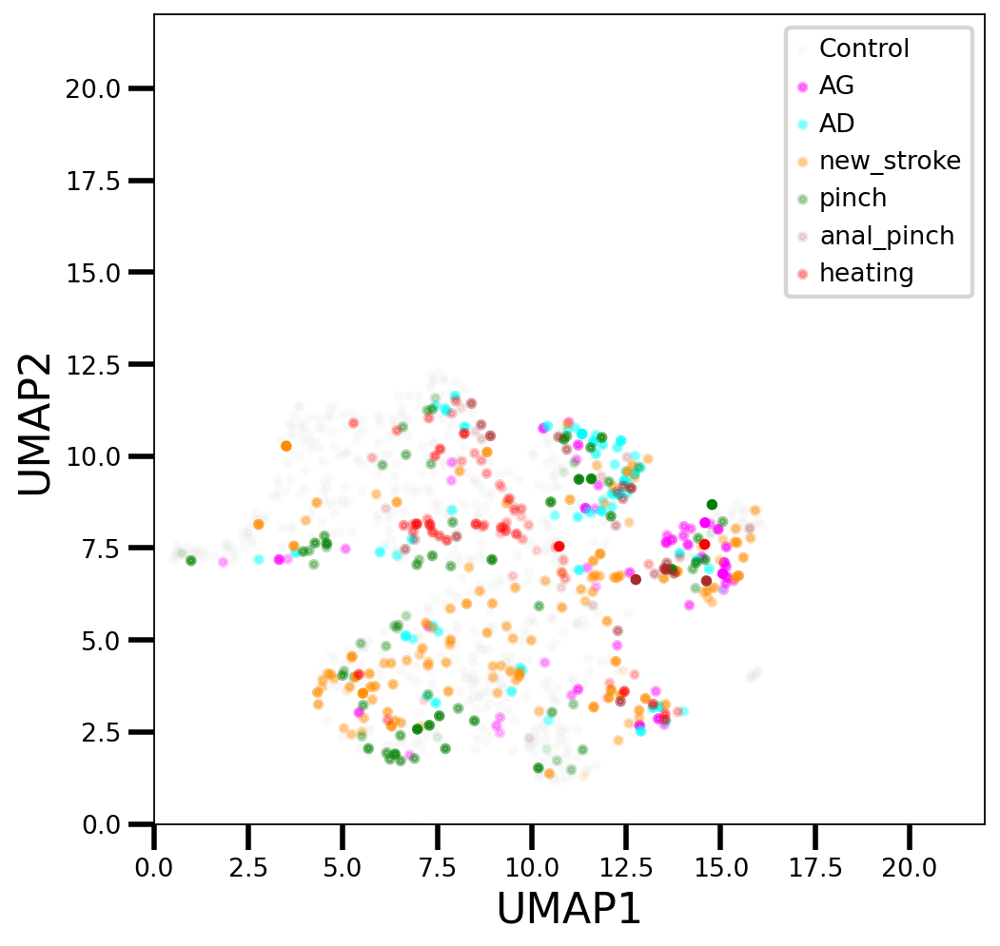

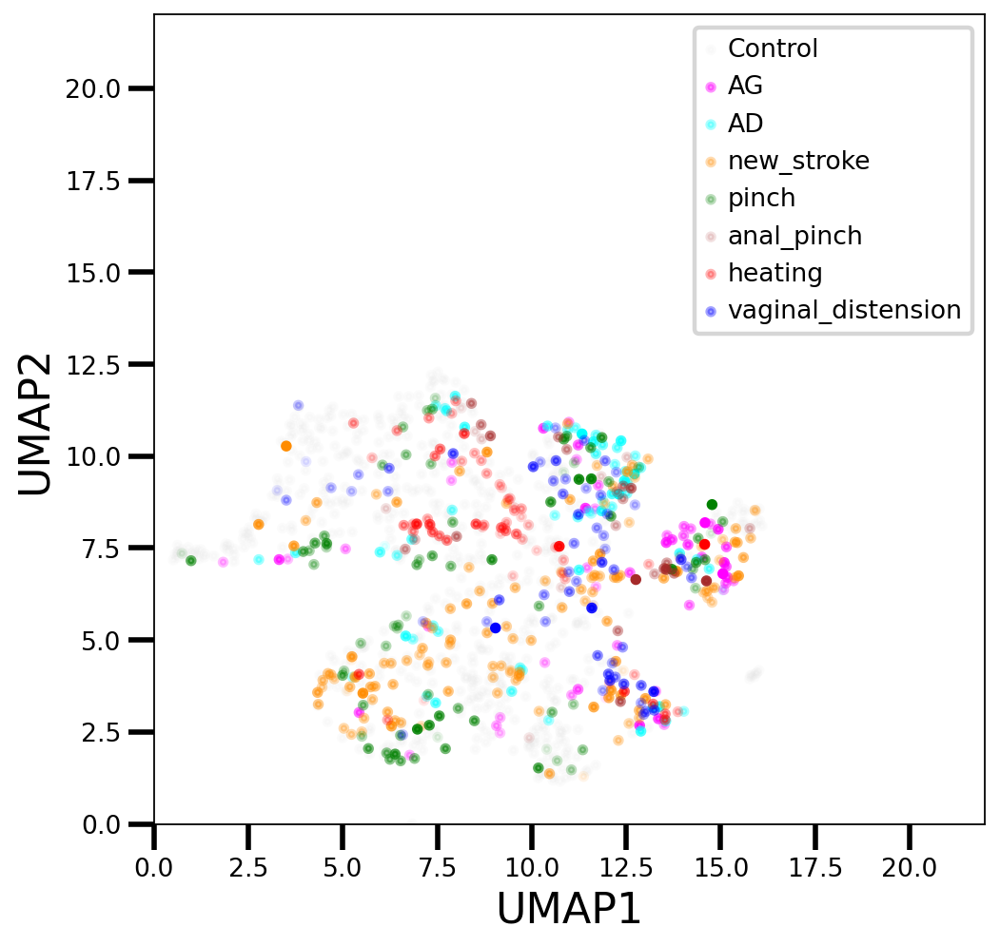

In [63]:
### plotting subsequent stimulus to add individually in a gif (only for selected stimuli)
stimulus_list = [0,4,5,2,1,9,6,11,12]
new_labels=['Control','AG','AD','new_stroke','pinch','anal_pinch','heating','vaginal_distension','non']
count = 0
for i in stimulus_list:
    print(i)
    figure, axes = plt.subplots()
    sublist = stimulus_list[0:count]
    print(sublist)
    for j in sublist:
        index = np.where(stim == j)[0]
        red_norm = (red[index] - np.min(red[index])) / (np.max(red[index]) - np.min(red[index]) + sys.float_info.epsilon)
        red_norm = (red_norm + 0.1)/1.1
        axes.scatter(adata.obsm['X_umap'][index,0],adata.obsm['X_umap'][index,1], s = 10, c = color[j],alpha = red_norm)

    axes.grid(visible = 'None')
    axes.set_xlim([0,22])
    axes.set_ylim([0,22])
    axes.set_xlabel('UMAP1', fontsize = 20)
    axes.set_ylabel('UMAP2', fontsize = 20)
    axes.tick_params(axis='both', which='major', labelsize=12)
    axes.tick_params(axis='both', which='minor', labelsize=12)
    axes.grid(False)
    axes.legend(new_labels, fontsize = 12)
    figure.set_size_inches([7,7])
    figure.savefig(figure_path + 'cum_stimulus'+ str(count) +'.png')

    count = count +1 

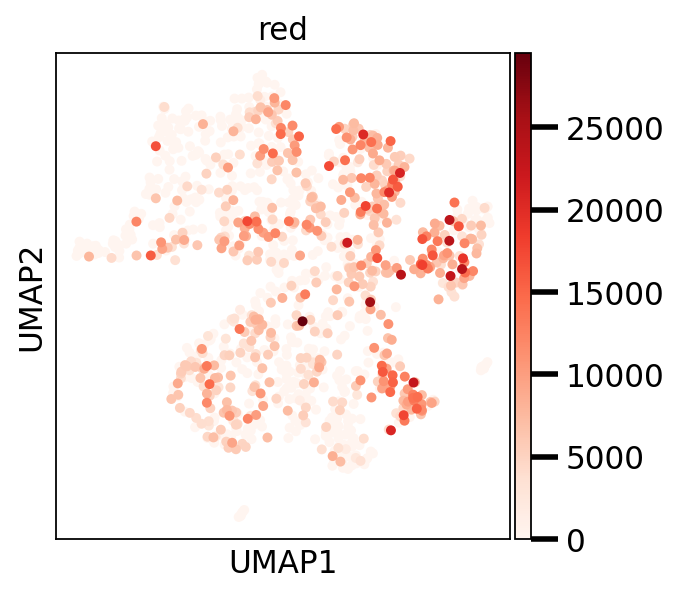

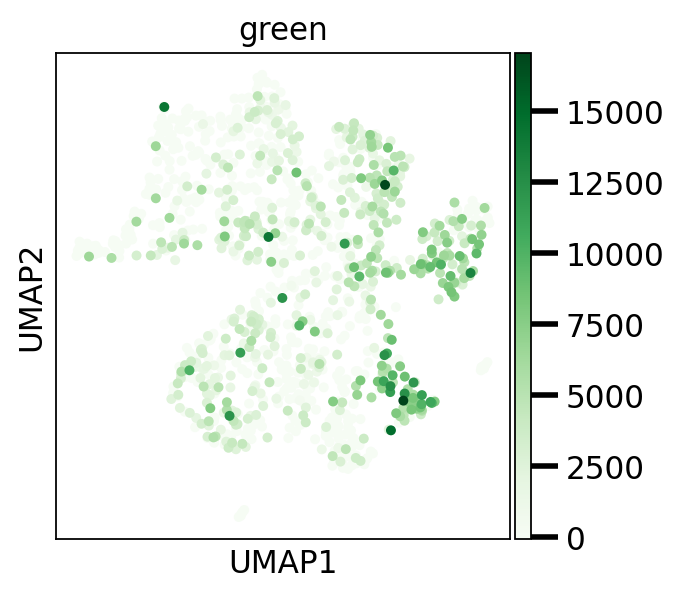

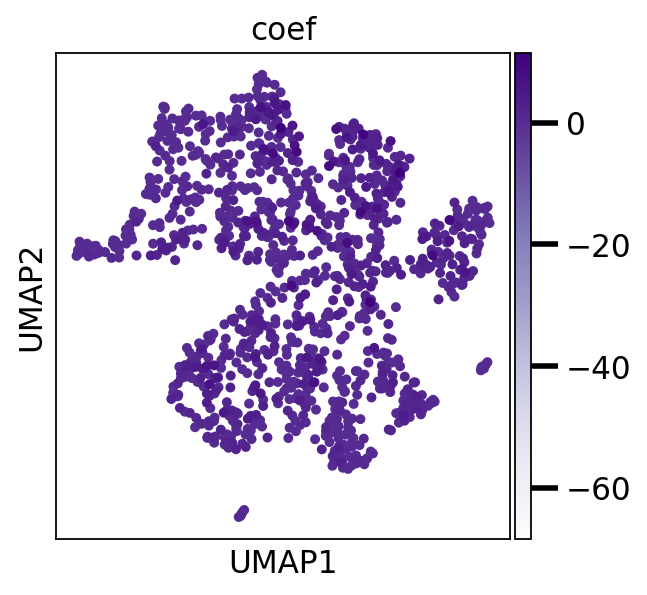

In [67]:
### plotting fluorecence levels 

sc.pl.umap(adata, color='red', color_map = 'Reds', save = 'UMIs/fluorecence/red_f' + '.png', size = 80)
sc.pl.umap(adata, color='green', color_map = 'Greens', save = 'UMIs/fluorecence/green_f' + '.png', size = 80)
adata.obs['coef'] = adata.obs['red']/(adata.obs['green'] + sys.float_info.epsilon)
sc.pl.umap(adata, color='coef', color_map = 'Purples', save = 'UMIs/fluorecence/coef_f' + '.png', size = 80)


(629, 25930)


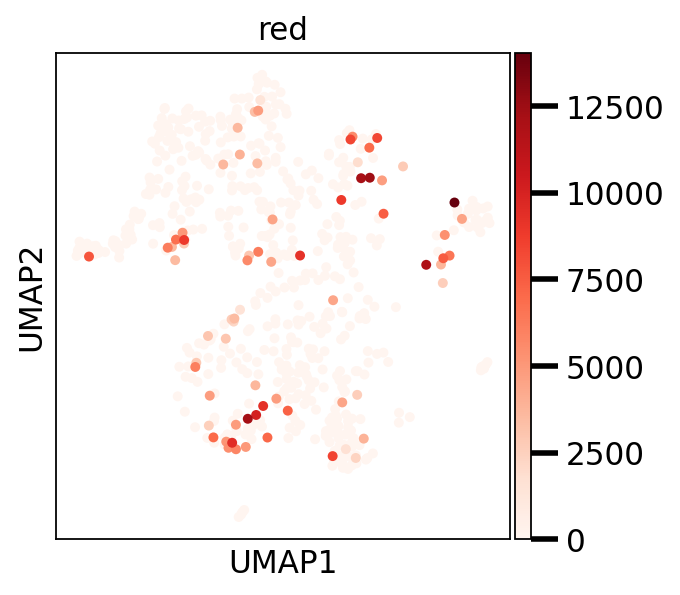

(686, 25930)


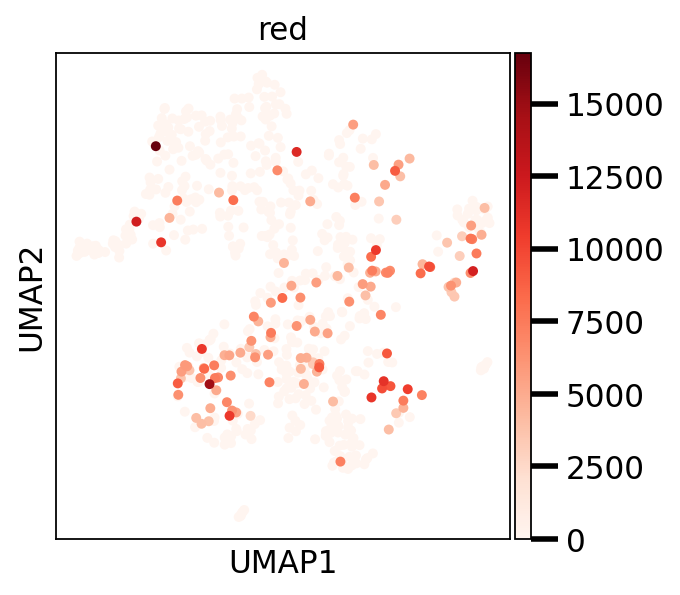

(561, 25930)


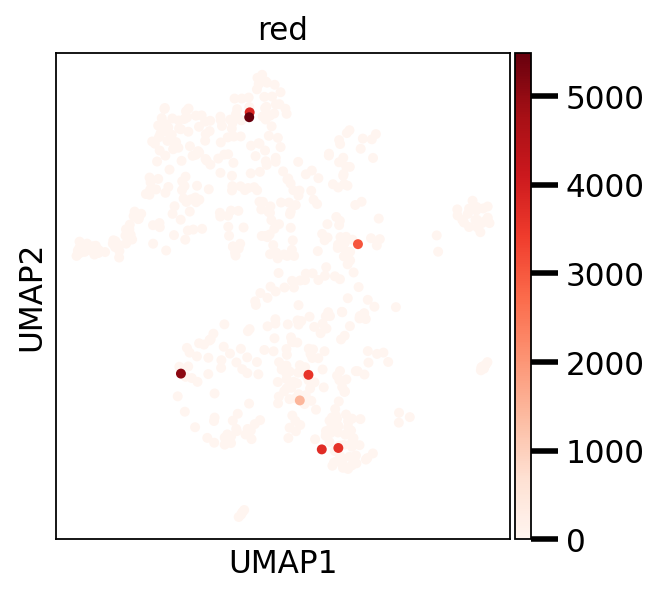

(604, 25930)


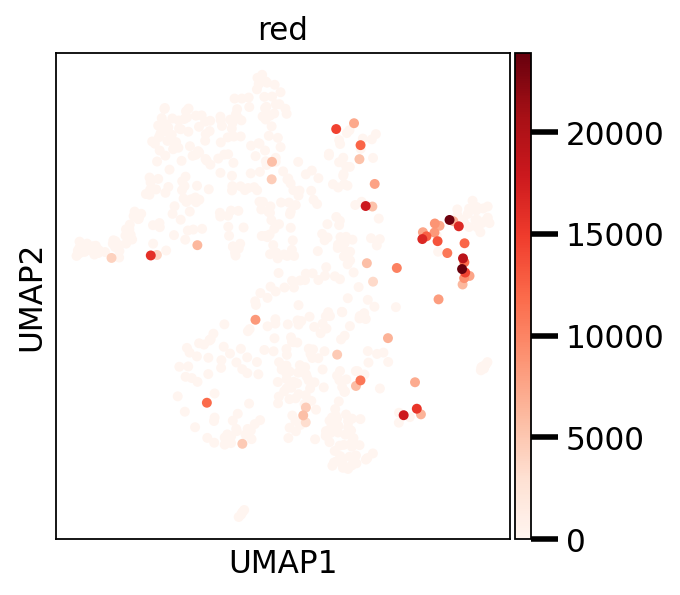

(614, 25930)


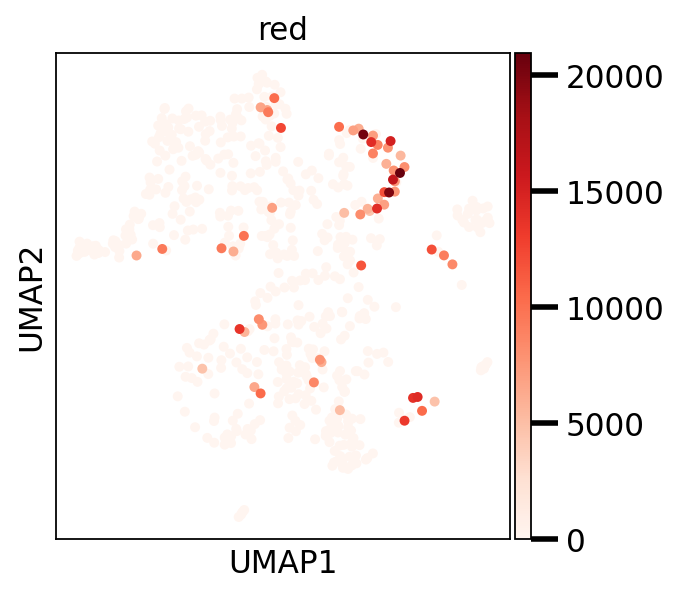

(616, 25930)


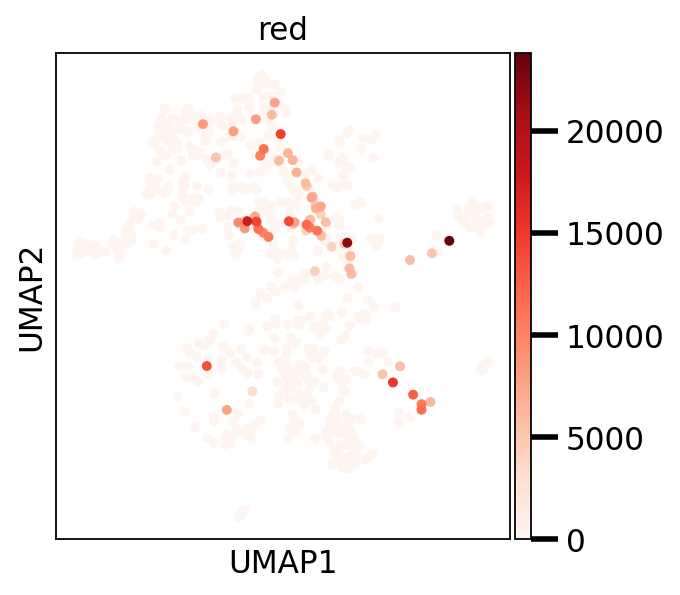

(569, 25930)


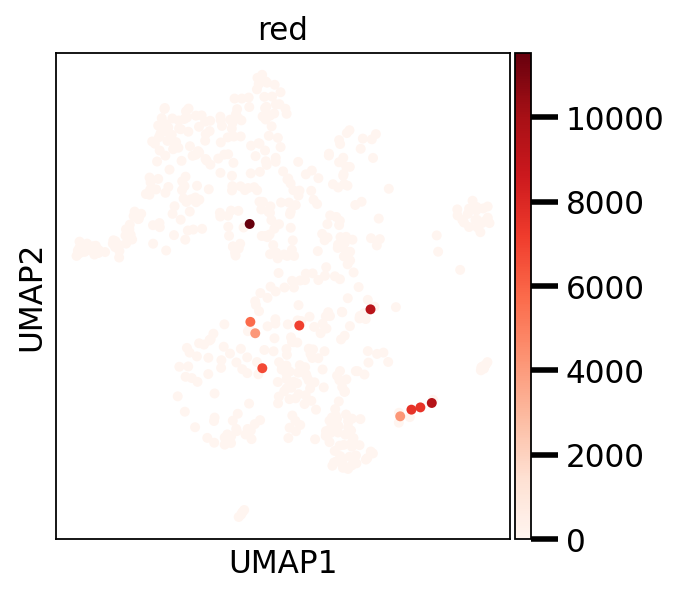

(608, 25930)


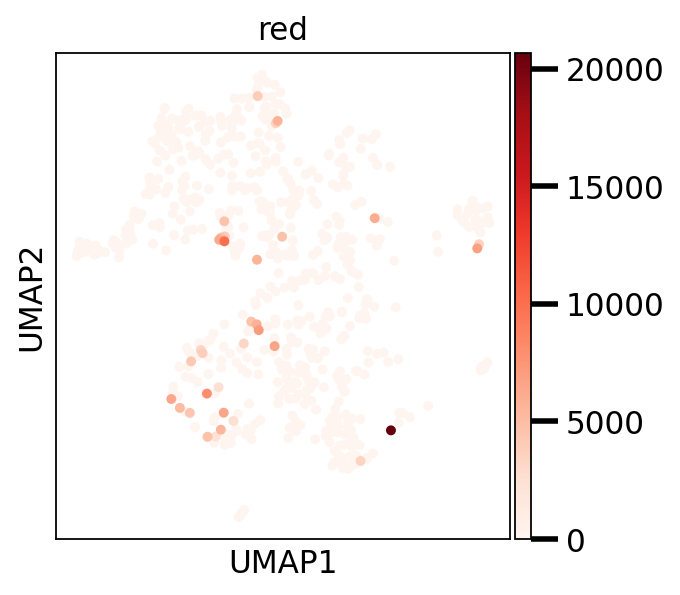

(585, 25930)


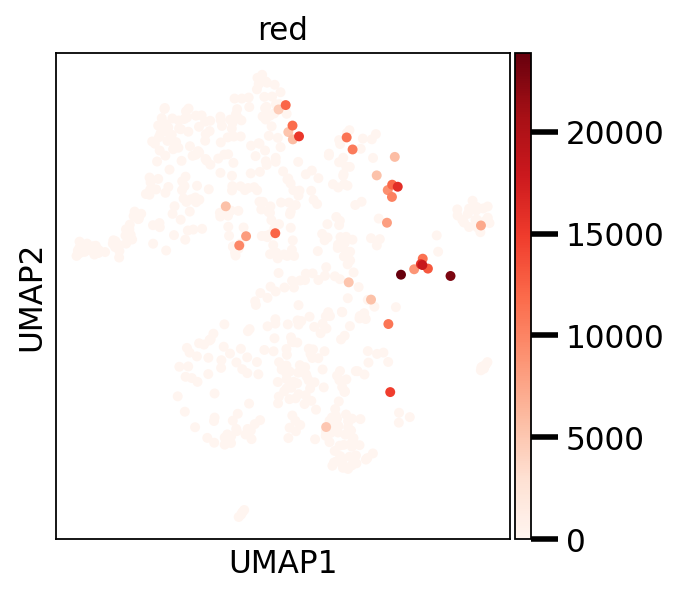

(557, 25930)


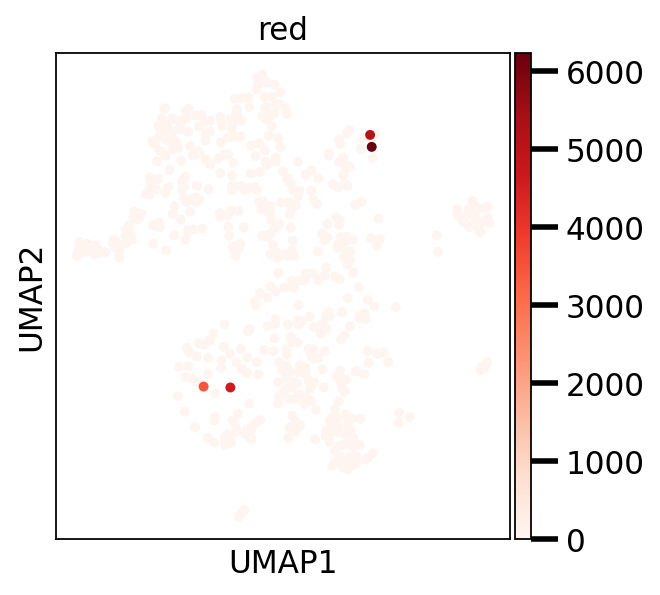

(612, 25930)


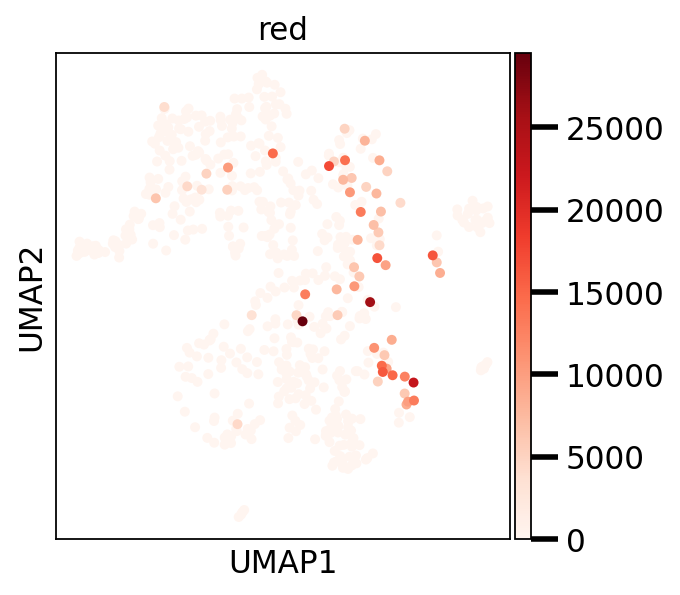

(575, 25930)


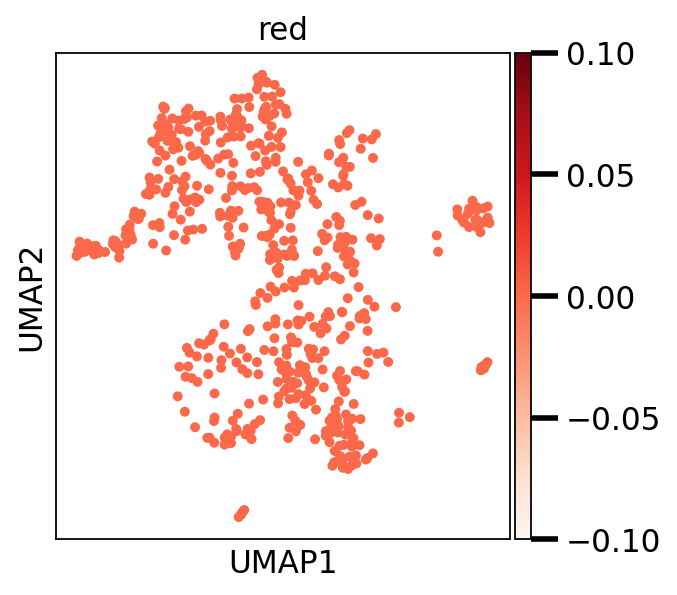

(554, 25930)


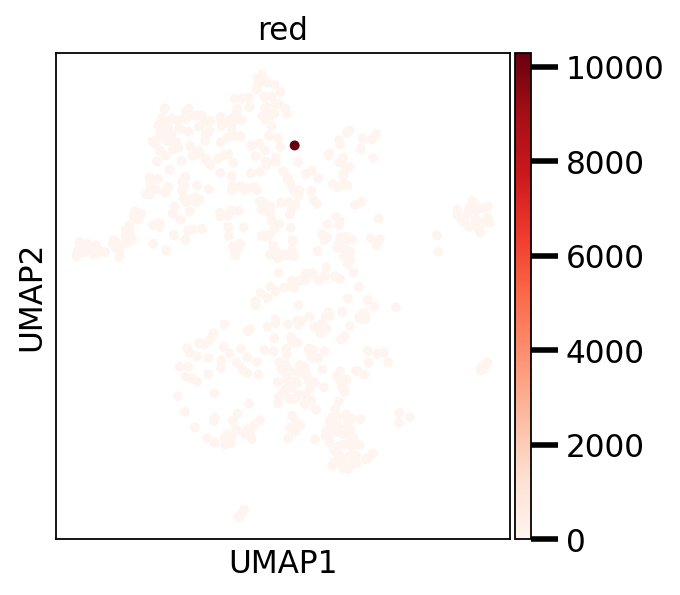

In [68]:
### plotting fluorecence levels stimulus by stimulus
for i in range(1,14):
    index = np.logical_or(adata.obs['stimulus'] == i,adata.obs['stimulus'] == 0)
    aux_adata = adata[index,:]
    print(aux_adata.shape)
    sc.pl.umap(aux_adata, color = 'red', color_map = 'Reds', save = 'UMIs/fluorecence/stimulus_red_' + labels[i]+ '.png', size = 80)
